# Group Project BOOKS dataset Recommender

By: 
* **Pablo Chamorro Casero**
* **Alexander Benady Calvo**

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import plotly.express as px
import seaborn as sns
from tqdm import tqdm
import recmetrics
import ast
import pickle
import os

from surprise import Reader, Dataset, SVD, SVDpp, NMF, accuracy, Prediction
from surprise.model_selection import train_test_split, cross_validate, KFold

my_seed = 3325

In [3]:
row_to_skip = 376979
reviews_df = pd.read_csv("/Users/pablochamorro/Desktop/Coding/Recommendation Engines/project/reviews_df.csv", skiprows=[row_to_skip])
books_df = pd.read_csv("/Users/pablochamorro/Desktop/Coding/Recommendation Engines/project/books_df.csv")
#users_df = pd.read_csv("/Users/pablochamorro/Desktop/Coding/Recommendation Engines/project/users_df.csv")

## Exploratory Data Analysis

### General

In [9]:
reviews_df.head(6)

,user_id,book_id,review_id,rating,review_text,date_added,read_at,n_votes
0,8842281e1d1347389f2ab93d60773d4d,2767052,248c011811e945eca861b5c31a549291,5,I cracked and finally picked this up. Very enj...,Wed Jan 13 13:38:25 -0800 2010,Sun Mar 25 00:00:00 -0700 2012,24
1,f8a89075dc6de14857561522e729f82c,18053080,785c8db878f4009da9741dea51f641da,4,Though the book started out slow and only star...,Sat Jan 11 17:58:41 -0800 2014,Sat Apr 12 00:00:00 -0700 2014,0
2,f8a89075dc6de14857561522e729f82c,17383543,34dc3c45d07e82718b05e73167259aef,2,"*Update - 10/27/13* - After some sleep, I thin...",Sun Apr 21 19:42:28 -0700 2013,Sat Oct 26 00:00:00 -0700 2013,0
3,f8a89075dc6de14857561522e729f82c,16651458,d8d6b590780256fef7ae4a9550fe3e0d,5,"This is a moving, heartbreaking, view into a l...",Fri Jan 11 11:42:42 -0800 2013,Mon Jan 14 00:00:00 -0800 2013,0
4,f8a89075dc6de14857561522e729f82c,10782699,972ce1267de0213e3032c685386890e6,5,I never thought I would enjoy a zombie books w...,Tue Oct 30 21:32:34 -0700 2012,Thu May 01 00:00:00 -0700 2014,0
5,704eb93a316aff687a93d5215882eb21,7260188,21063e8930ec28bc54e76f932aa30ce1,5,What a great ending to the trilogy!! The secon...,Fri Jul 20 14:00:41 -0700 2012,Fri Apr 12 00:00:00 -0700 2013,0


In [10]:
print(f"There are {reviews_df['user_id'].nunique()} unique users")
print(f"There are {reviews_df['book_id'].nunique()} unique movies")
print(f"There are {reviews_df.shape[0]} ratings")

There are 35692 unique users
There are 25833 unique movies
There are 376978 ratings


From what we can see above, there are a similar amount of books and users, and a significant higher numnber of reviews/ratings, which means that we will have a lot of data for our collaborative filtering model to learn from.

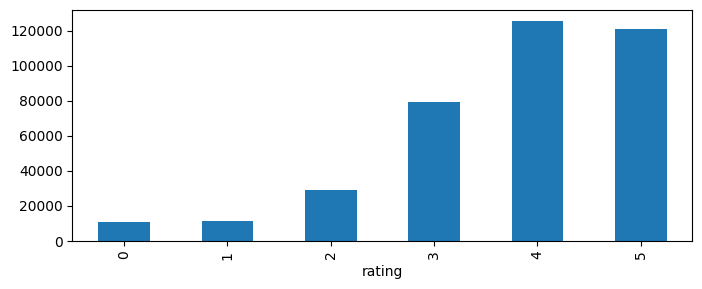

In [11]:
plt.subplots(figsize=(8,3))
reviews_df.groupby('rating').size().plot.bar();

As can be seen, generally, the ratings are very positive, with most of them around 4-5. This is most probably due to the fact that when people buy books, they already assume that the book they bought is to their liking.

In [12]:
mean = reviews_df['rating'].mean()
std = reviews_df['rating'].std()
print(f'The ratings mean is {round(mean, 2)} and std is {round(std, 4)}')

The ratings mean is 3.75 and std is 1.2248


In [13]:
def basic_stats(df, user_col, item_col):
  n_ratings = df.shape[0]
  n_users = df[user_col].nunique()
  n_items = df[item_col].nunique()
  print(f'There are {n_ratings} ratings from {n_users} users to {n_items} books')
  return n_ratings, n_users, n_items

n_ratings, n_users, n_items = basic_stats(reviews_df, 'user_id', 'book_id')

print(f"There are {round(n_ratings/n_users, 2)} number of ratings per user")
print(f"There are {round(n_ratings/n_items, 2)} number of ratings per book")

There are 376978 ratings from 35692 users to 25833 books
There are 10.56 number of ratings per user
There are 14.59 number of ratings per book


This looks like a good average, given that 10 valuable ratings per user and 14 per book can be used to make the model learn and extract latent factors.

In [14]:
density_movies = reviews_df.shape[0]/(reviews_df['user_id'].nunique()*reviews_df['book_id'].nunique())
print("The density of the movies dataframe is: ", density_movies)

The density of the movies dataframe is:  0.0004088559080321856


In general, even though it seems a low density, compared to other datasets, it is not that bad of a value for the concept of density.

/Users/pablochamorro/Desktop/Coding/Chamorro.venv/lib/python3.12/site-packages/seaborn/_decorators.py:36: FutureWarning:

Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.

/Users/pablochamorro/Desktop/Coding/Chamorro.venv/lib/python3.12/site-packages/recmetrics/plots.py:60: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.



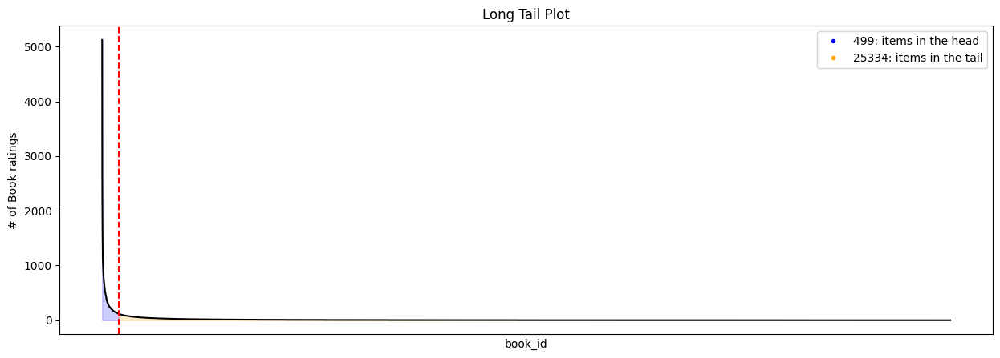

In [15]:
plt.figure(figsize=(15, 5))
recmetrics.long_tail_plot(df = reviews_df,
                          item_id_column="book_id",
                          interaction_type="Book ratings",
                          percentage=0.5,
                          x_labels=False)

In [16]:
# 5% of the books are responsible of >65% of the ratings
reviews_df.groupby('book_id').size().sort_values(ascending=False).cumsum().iloc[int(n_items*0.05)] / reviews_df.shape[0] * 100

65.273835608444

/Users/pablochamorro/Desktop/Coding/Chamorro.venv/lib/python3.12/site-packages/seaborn/_decorators.py:36: FutureWarning:

Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.

/Users/pablochamorro/Desktop/Coding/Chamorro.venv/lib/python3.12/site-packages/recmetrics/plots.py:60: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.



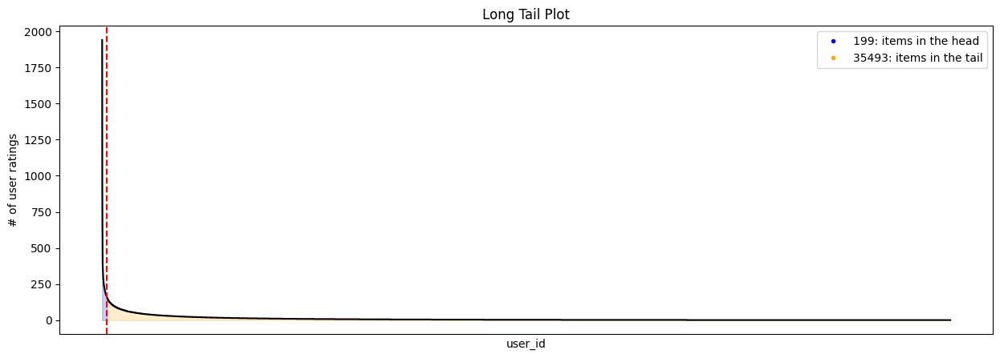

In [17]:
plt.figure(figsize=(15, 5))
recmetrics.long_tail_plot(df=reviews_df,
                          item_id_column="user_id",
                          interaction_type="user ratings",
                          percentage=0.15,
                          x_labels=False)

In [18]:
# 5% of the users are responsible of >46% of the ratings
reviews_df.groupby('user_id').size().sort_values(ascending=False).cumsum().iloc[int(n_users*0.05)] / reviews_df.shape[0] * 100

46.110117831809816

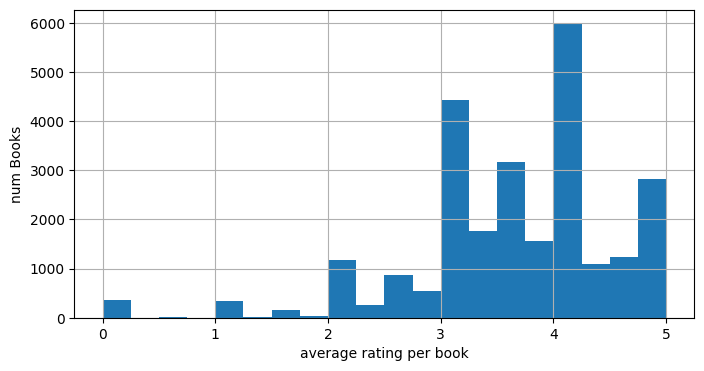

In [19]:
plt.figure(figsize=(8, 4))
reviews_df.groupby('book_id')['rating'].mean().hist(bins=np.arange(0, 5.25, 0.25));
plt.xlabel('average rating per book');
plt.ylabel('num Books');

As it can be seen in this graph, the average rating per book is generally around 4, followed by 3-3.5 and then 5.

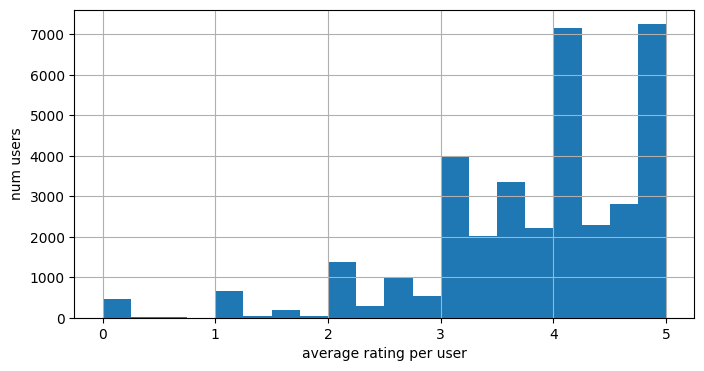

In [20]:
plt.figure(figsize=(8, 4))
reviews_df.groupby('user_id')['rating'].mean().hist(bins=np.arange(0, 5.25, 0.25));
plt.xlabel('average rating per user');
plt.ylabel('num users');

Interesting the average rating per user is around 4 and 5, meaning that in generally the user rates better than the books are rated. This might be due to the fact that some users only rate with 4 and 5, whilst few users rate with lower marks.

### Time

In [21]:
reviews_df.columns

Index(['user_id', 'book_id', 'review_id', 'rating', 'review_text',
       'date_added', 'read_at', 'n_votes'],
      dtype='object')

In [22]:
reviews_df.dtypes

user_id        object
book_id         int64
review_id      object
rating          int64
review_text    object
date_added     object
read_at        object
n_votes         int64
dtype: object

In [23]:
reviews_df.head(2)

,user_id,book_id,review_id,rating,review_text,date_added,read_at,n_votes
0,8842281e1d1347389f2ab93d60773d4d,2767052,248c011811e945eca861b5c31a549291,5,I cracked and finally picked this up. Very enj...,Wed Jan 13 13:38:25 -0800 2010,Sun Mar 25 00:00:00 -0700 2012,24
1,f8a89075dc6de14857561522e729f82c,18053080,785c8db878f4009da9741dea51f641da,4,Though the book started out slow and only star...,Sat Jan 11 17:58:41 -0800 2014,Sat Apr 12 00:00:00 -0700 2014,0


In [24]:
reviews_df.read_at

0         Sun Mar 25 00:00:00 -0700 2012
1         Sat Apr 12 00:00:00 -0700 2014
2         Sat Oct 26 00:00:00 -0700 2013
3         Mon Jan 14 00:00:00 -0800 2013
4         Thu May 01 00:00:00 -0700 2014
                       ...              
376973    Sun Jun 19 11:21:03 -0700 2016
376974    Tue Jun 21 00:00:00 -0700 2016
376975    Thu Jul 28 12:56:43 -0700 2016
376976    Sat May 21 10:18:43 -0700 2016
376977    Sun Jun 12 00:00:00 -0700 2016
Name: read_at, Length: 376978, dtype: object

In [25]:
# Convert 'read_at' timestamp to datetime
reviews_df['timestamp'] = pd.to_datetime(reviews_df['read_at'], format='%a %b %d %H:%M:%S %z %Y', errors='coerce')
reviews_df['timestamp'] = pd.to_datetime(reviews_df['timestamp'], utc=True, errors='coerce')

# Count the number of rows with invalid timestamps
deleted_rows = len(reviews_df) - len(reviews_df.dropna(subset=['timestamp']))

# Remove rows with invalid timestamps
reviews_df = reviews_df.dropna(subset=['timestamp'])

print("Number of rows deleted:", deleted_rows)


Number of rows deleted: 57152


Around 57k reviews have been deleted, because they had some issues with the dates. Given that we had around 400k rows, it is not that much of a difference.

Let's see how this has affected the number of ratings per user and book.

In [26]:
def basic_stats(df, user_col, item_col):
  n_ratings = df.shape[0]
  n_users = df[user_col].nunique()
  n_items = df[item_col].nunique()
  print(f'There are {n_ratings} ratings from {n_users} users to {n_items} books')
  return n_ratings, n_users, n_items

n_ratings, n_users, n_items = basic_stats(reviews_df, 'user_id', 'book_id')

print(f"There are {round(n_ratings/n_users, 2)} number of ratings per user")
print(f"There are {round(n_ratings/n_items, 2)} number of ratings per book")

There are 319826 ratings from 30954 users to 23697 books
There are 10.33 number of ratings per user
There are 13.5 number of ratings per book


As seen the effect has been absolutely minimal, which is very good!

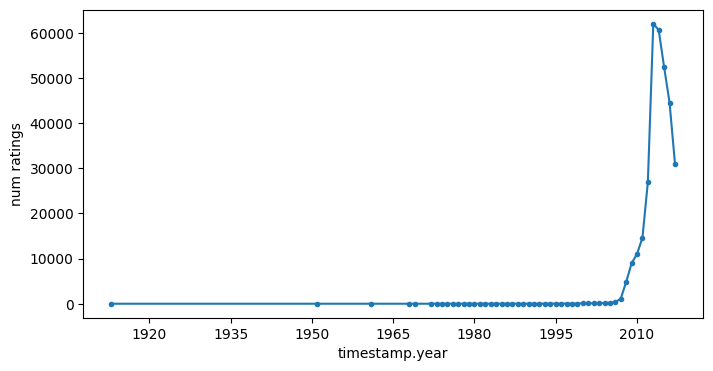

In [27]:
reviews_df['timestamp.year'] = reviews_df['timestamp'].dt.year

fig, ax = plt.subplots(figsize=(8, 4))
reviews_df.groupby('timestamp.year').size().plot(marker='.');

# just aesthetic to show integer x axis
from matplotlib.ticker import MaxNLocator
ax.xaxis.set_major_locator(MaxNLocator(integer=True))
plt.ylabel('num ratings');

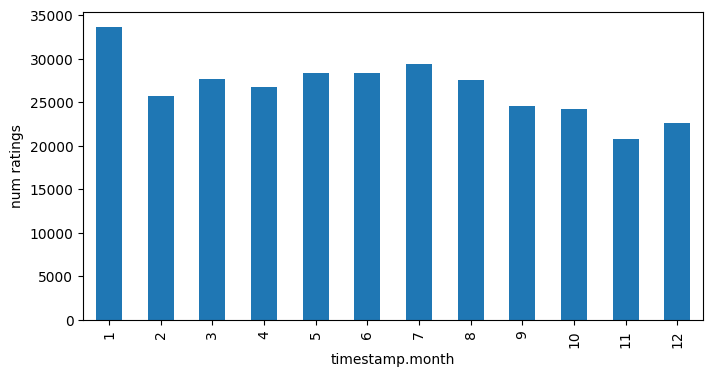

In [28]:
reviews_df['timestamp.month'] = reviews_df['timestamp'].dt.month

plt.figure(figsize=(8, 4))
reviews_df.groupby('timestamp.month').size().plot.bar();
plt.ylabel('num ratings');

As it can be seen, the histogram is very very indifferent, as the same number of books approximately have been rated throughout all of the months of the year.

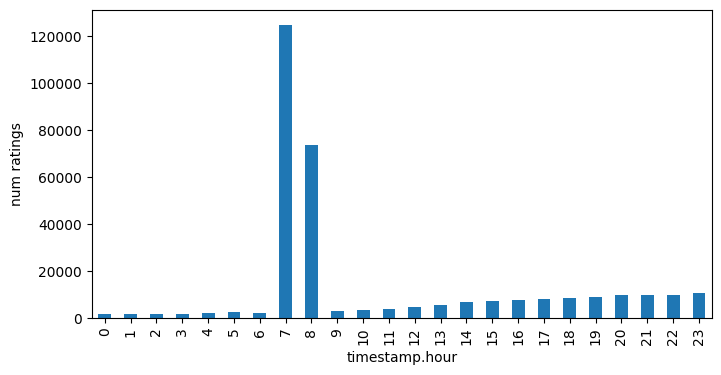

In [29]:
reviews_df['timestamp.hour'] = reviews_df['timestamp'].dt.hour

plt.figure(figsize=(8, 4))
reviews_df.groupby('timestamp.hour').size().plot.bar();
plt.ylabel('num ratings');

As seen, most of the books have been reviewed during 7 and 8 am, which most probably is the default value, as very unlikely the reviews have really been rated at that time.

### Genres

In [30]:
books_df.head(3)

,book_id,isbn,title,average_rating,publisher,description,series,country_code,num_pages,publication_date,authors,genres
0,21401181,0698143760,"Half Bad (Half Life, #1)",3.80,Viking Children's,Wanted by no one.\nHunted by everyone.\nSixtee...,['493993'],US,416,2014-03-04,"[{'author_id': '7314532', 'role': '', 'name': ...","{'fantasy, paranormal': 2673, 'young-adult': 1..."
1,22642971,0990662616,The Body Electric,3.71,Scripturient Books,The future world is at peace.\nElla Shepherd h...,[],US,351,2014-10-06,"[{'author_id': '4018722', 'role': '', 'name': ...","{'young-adult': 235, 'fiction': 182, 'romance'..."
2,31556136,0062373374,Like Water,3.89,Balzer + Bray,A gorgeously written and deeply felt literary ...,[],US,304,2017-10-17,"[{'author_id': '6537142', 'role': '', 'name': ...","{'young-adult': 63, 'romance': 10, 'fiction': 18}"


In [31]:
books_df['genres'] = books_df['genres'].apply(lambda x: list(ast.literal_eval(x).keys()))
df_genres = books_df.explode('genres')
df_genres.head()


,book_id,isbn,title,average_rating,publisher,description,series,country_code,num_pages,publication_date,authors,genres
0,21401181,0698143760,"Half Bad (Half Life, #1)",3.80,Viking Children's,Wanted by no one.\nHunted by everyone.\nSixtee...,['493993'],US,416,2014-03-04,"[{'author_id': '7314532', 'role': '', 'name': ...","fantasy, paranormal"
0,21401181,0698143760,"Half Bad (Half Life, #1)",3.80,Viking Children's,Wanted by no one.\nHunted by everyone.\nSixtee...,['493993'],US,416,2014-03-04,"[{'author_id': '7314532', 'role': '', 'name': ...",young-adult
0,21401181,0698143760,"Half Bad (Half Life, #1)",3.80,Viking Children's,Wanted by no one.\nHunted by everyone.\nSixtee...,['493993'],US,416,2014-03-04,"[{'author_id': '7314532', 'role': '', 'name': ...",fiction
0,21401181,0698143760,"Half Bad (Half Life, #1)",3.80,Viking Children's,Wanted by no one.\nHunted by everyone.\nSixtee...,['493993'],US,416,2014-03-04,"[{'author_id': '7314532', 'role': '', 'name': ...",romance
1,22642971,0990662616,The Body Electric,3.71,Scripturient Books,The future world is at peace.\nElla Shepherd h...,[],US,351,2014-10-06,"[{'author_id': '4018722', 'role': '', 'name': ...",young-adult


In [32]:
import plotly.graph_objects as go

# Create histogram
fig = go.Figure(go.Histogram(x=df_genres['genres']))

# Update layout
fig.update_layout(
    height=400,
    title='Movie count by genre',
    xaxis=dict(categoryorder="total descending")
)

fig.show()

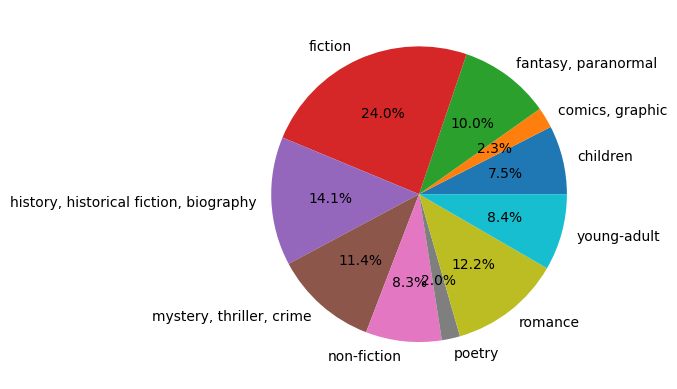

In [33]:
df_genres.groupby('genres').size().plot.pie(autopct='%.1f%%');

As it can be seen above, fiction is the most common genre, followed by history, but with a difference of 100 thousand movies.

## Random & Popular Recommender

In [24]:
# Filter the DataFrame to include only users with more than 20 ratings
users_with_more_than_20_ratings = reviews_df['user_id'].value_counts()[reviews_df['user_id'].value_counts() > 20].index
reviews_df_filtered = reviews_df[reviews_df['user_id'].isin(users_with_more_than_20_ratings)]
reviews_df_filtered.reset_index(drop=True, inplace=True)
reviews_df_filtered.shape[0]

243886

In [25]:
reader = Reader(rating_scale=(0, 5))
data = Dataset.load_from_df(reviews_df_filtered[['user_id', 'book_id', 'rating']], reader)

In [26]:
trainset, testset = train_test_split(data, test_size=.20, random_state=my_seed)

In [27]:
mean = reviews_df_filtered['rating'].mean()
std = reviews_df_filtered['rating'].std()
print(f'The ratings mean is {round(mean, 2)} and std is {round(std, 4)}')

The ratings mean is 3.71 and std is 1.214


In [28]:
user_id = 'd94b47c0efb5d0c0f16cb2c179d972ef'
item_id = 24465809

In [29]:
def random_predict(user, item):
  return np.random.normal(loc=mean, scale=std)

In [30]:
random_predict(user_id, item_id)

3.5254521486367216

In [31]:
from surprise import Reader, AlgoBase

In [32]:
class MyRandomAlgorithm(AlgoBase):

    def __init__(self):
        AlgoBase.__init__(self)

    def estimate(self, u, i):
        # Note u and i are not used, this RS does not personalize based on neither the user nor the item
        return np.random.normal(loc=self.train_mean, scale=self.train_std)

    def fit(self, trainset):
        AlgoBase.fit(self, trainset)

        ratings = [r for (_, _, r) in self.trainset.all_ratings()]
        self.train_mean = np.mean(ratings)
        self.train_std = np.std(ratings)

        return self

random_RS = MyRandomAlgorithm()

In [33]:
random_RS.fit(trainset);
predictions_random = random_RS.test(testset)
accuracy.rmse(predictions_random, verbose=True);

RMSE: 1.6152


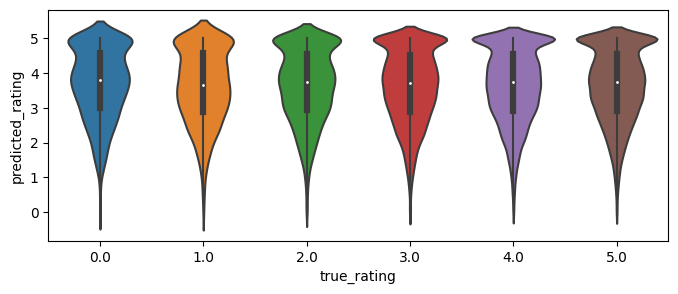

In [34]:
columns=['user', 'item', 'true_rating', 'predicted_rating', 'details']
predictions_random_df = pd.DataFrame(predictions_random, columns=columns)

plt.subplots(figsize=(8,3));
sns.violinplot(data=predictions_random_df, x="true_rating", y="predicted_rating");

The accuracy seems to be quite bad, compared to other type of models like the item, user and item models.

In [35]:
cross_validate(random_RS, data, measures=['RMSE', 'MAE'],
               cv=KFold(n_splits=5, random_state=my_seed),
               return_train_measures=True, n_jobs=-1, verbose=True);

Evaluating RMSE, MAE of algorithm MyRandomAlgorithm on 5 split(s).

                  Fold 1  Fold 2  Fold 3  Fold 4  Fold 5  Mean    Std     
RMSE (testset)    1.6179  1.6246  1.6226  1.6126  1.6148  1.6185  0.0045  
MAE (testset)     1.2672  1.2705  1.2707  1.2628  1.2638  1.2670  0.0033  
RMSE (trainset)   1.6162  1.6201  1.6134  1.6191  1.6143  1.6166  0.0026  
MAE (trainset)    1.2647  1.2679  1.2623  1.2688  1.2636  1.2655  0.0025  
Fit time          0.02    0.02    0.02    0.02    0.02    0.02    0.00    
Test time         0.08    0.08    0.07    0.08    0.07    0.08    0.00    


Let's go with Popular Recommender

In [36]:
class MyPopularAlgorithm(AlgoBase):

    def __init__(self):
        AlgoBase.__init__(self)

    def estimate(self, u, i):
        # Note u is not used, this RS does not personalize based on the user
        if i in self.mean_rating_per_item_df.index:
          return self.mean_rating_per_item_df.loc[i]['rating']
        else:
          return self.trainset.global_mean

    def fit(self, trainset):
        AlgoBase.fit(self, trainset)

        ratings_df = pd.DataFrame([[i, r] for (_, i, r) in self.trainset.all_ratings()],
                                  columns=['item', 'rating'])

        self.mean_rating_per_item_df = (ratings_df
          .groupby('item')
          .agg({'rating': 'mean'})
        )

        return self

popular_RS = MyPopularAlgorithm()

In [37]:
popular_RS.fit(trainset);
predictions_popular = popular_RS.test(testset)
accuracy.rmse(predictions_popular, verbose=True);

RMSE: 1.1940


The accuracy is way less than the SVD, but it is still quite good compared to the random recommender

In [38]:
columns=['user', 'item', 'true_rating', 'predicted_rating', 'details']
predictions_popular_df = pd.DataFrame(predictions_popular, columns=columns)
predictions_popular_df.head()

,user,item,true_rating,predicted_rating,details
0,5cca1dd30cd5a98c1c8e731839265ccf,2954411,4.0,3.773196,{'was_impossible': False}
1,2e6d214902d16f63c781a6262f2aaccd,12578305,4.0,3.035088,{'was_impossible': False}
2,ac1f8cb05733d765da3f7b2f30677cbf,11043618,4.0,3.462500,{'was_impossible': False}
3,fb1ba244d692fc877bf19d1bf29f893a,9266794,4.0,3.818182,{'was_impossible': False}
4,de7d29c9c5447ee23838856f733b415f,11614718,5.0,3.838129,{'was_impossible': False}


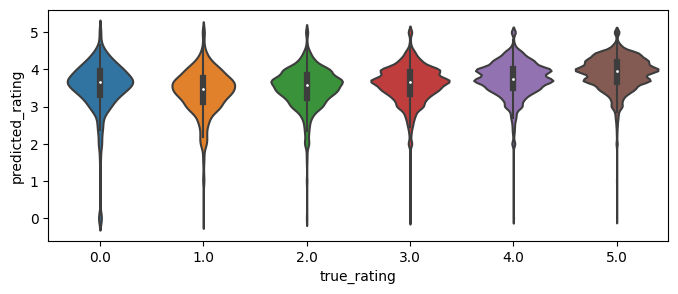

In [39]:
predictions_popular_df = pd.DataFrame(predictions_popular, columns=columns)

plt.subplots(figsize=(8,3));
sns.violinplot(data=predictions_popular_df, x="true_rating", y="predicted_rating");

In [40]:
cross_validate(popular_RS, data, measures=['RMSE', 'MAE'],
               cv=KFold(n_splits=5, random_state=my_seed),
               return_train_measures=True, n_jobs=-1, verbose=True);

Evaluating RMSE, MAE of algorithm MyPopularAlgorithm on 5 split(s).

                  Fold 1  Fold 2  Fold 3  Fold 4  Fold 5  Mean    Std     
RMSE (testset)    1.1985  1.2023  1.1973  1.1884  1.1940  1.1961  0.0047  
MAE (testset)     0.9088  0.9103  0.9089  0.9033  0.9078  0.9078  0.0024  
RMSE (trainset)   1.0799  1.0789  1.0808  1.0817  1.0813  1.0805  0.0010  
MAE (trainset)    0.8034  0.8026  0.8040  0.8043  0.8040  0.8037  0.0006  
Fit time          0.11    0.12    0.12    0.10    0.10    0.11    0.01    
Test time         0.55    0.53    0.52    0.53    0.52    0.53    0.01    


Let's go with a usual CF Recommender

In [41]:
cf_RS = SVD(random_state=my_seed)

In [42]:
cf_RS.fit(trainset);
predictions_cf = cf_RS.test(testset)
accuracy.rmse(predictions_cf, verbose=True);

RMSE: 1.0669


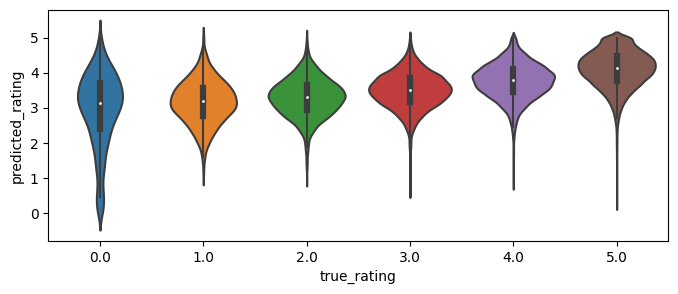

In [43]:
predictions_cf_df = pd.DataFrame(predictions_cf, columns=columns)

plt.subplots(figsize=(8,3));
sns.violinplot(data=predictions_cf_df, x="true_rating", y="predicted_rating");

If we compare all of the predictions plot, we can see how there is a slight improvement when going from random to popular, mostly for the higher true ratings. Nonetheless, the considerable change goes we compare both the random and popular recommender to the collaborative filtering model.

In [44]:
cross_validate(cf_RS, data, measures=['RMSE', 'MAE'],
               cv=KFold(n_splits=5, random_state=my_seed),
               return_train_measures=True, n_jobs=-1, verbose=True);

Evaluating RMSE, MAE of algorithm SVD on 5 split(s).

                  Fold 1  Fold 2  Fold 3  Fold 4  Fold 5  Mean    Std     
RMSE (testset)    1.0590  1.0698  1.0631  1.0562  1.0669  1.0630  0.0050  
MAE (testset)     0.7981  0.8023  0.7979  0.7967  0.8006  0.7991  0.0020  
RMSE (trainset)   0.7313  0.7288  0.7292  0.7314  0.7281  0.7298  0.0013  
MAE (trainset)    0.5552  0.5538  0.5547  0.5556  0.5538  0.5546  0.0007  
Fit time          0.91    0.89    0.89    0.86    0.85    0.88    0.02    
Test time         0.12    0.12    0.12    0.11    0.12    0.12    0.00    


As it can be seen, there is a clear RMSE outperformance in the trainset compared to the testset in terms of RMSE. Nonetheless, it isn't that big, because there should be only a few books with only one rating.

Let's make sure!

In [45]:
id_counts = reviews_df_filtered['book_id'].value_counts()

# Step 2: Count the number of unique counts
unique_counts = id_counts.value_counts()

# Step 3: Calculate the percentage of ISBNs that appear only once
percentage_single_ratings = (unique_counts.get(1, 0) / len(id_counts)) * 100
percentage_single_ratings

38.70996640537514

It can be this 38% of books that only appear once, which can be making the RMSE be worse in the testset, as the model might not have been able to learn (train) from it.

In [46]:
train_rmse_mean_list = []
train_rmse_std_list = []
test_rmse_mean_list = []
test_rmse_std_list = []

k_range = [2, 3, 4, 10, 20]
for k in tqdm(k_range):
  performance = cross_validate(cf_RS, data, measures=['RMSE'],
                               cv=KFold(n_splits=k, random_state=my_seed),
                               return_train_measures=True, n_jobs=-1, verbose=False)
  train_rmse_mean_list.append(np.mean(performance['train_rmse']))
  train_rmse_std_list.append(np.std(performance['train_rmse']))
  test_rmse_mean_list.append(np.mean(performance['test_rmse']))
  test_rmse_std_list.append(np.std(performance['test_rmse']))

100%|██████████| 5/5 [00:22<00:00,  4.43s/it]


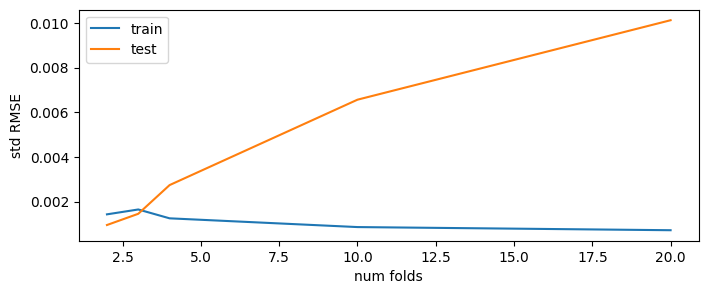

In [47]:
plt.subplots(figsize=(8,3))
plt.plot(k_range, train_rmse_std_list, label='train');
plt.plot(k_range, test_rmse_std_list, label='test');
plt.xlabel('num folds');
plt.ylabel('std RMSE');
plt.legend();

We can see that from the plot above the optimal number of folds would be: 2, as it has the best RMSE for both test and train set, without leading to overfitting (too many folds on the training set, and too little on the test set).

In [48]:
# https://github.com/NicolasHug/Surprise/blob/master/examples/top_n_recommendations.py
def get_top_n(predictions, n=10, solve_ties=False):
    from collections import defaultdict
    """Return the top-N recommendation for each user from a set of predictions.

    Args:
        predictions(list of Prediction objects): The list of predictions, as
            returned by the test method of an algorithm.
        n(int): The number of recommendation to output for each user. Default
            is 10.
        solve_ties(bool): Solve prediction ties by using the item id.

    Returns:
    A dict where keys are user (raw) ids and values are lists of tuples:
        [(raw item id, rating estimation), ...] of size n.
    """

    # First map the predictions to each user.
    top_n = defaultdict(list)
    for uid, iid, true_r, est, _ in predictions:
        top_n[uid].append((iid, est))

    # Then sort the predictions for each user and retrieve the k highest ones.
    for uid, user_ratings in top_n.items():
        if solve_ties:
            user_ratings.sort(key=lambda x: (x[1], x[0]), reverse=True)
        else:
            user_ratings.sort(key=lambda x: x[1], reverse=True)
        top_n[uid] = user_ratings[:n]

    return top_n

In [49]:
top_n_random  = get_top_n(predictions_random, n=19)
top_n_popular = get_top_n(predictions_popular, n=19, solve_ties=True)  # Remove randomness
top_n_cf      = get_top_n(predictions_cf, n=19)

In [50]:
top_n_random_only_items  = [[iid for (iid, _) in user_ratings] for user_ratings in top_n_random.values()]
top_n_popular_only_items = [[iid for (iid, _) in user_ratings] for user_ratings in top_n_popular.values()]
top_n_cf_only_items      = [[iid for (iid, _) in user_ratings] for user_ratings in top_n_cf.values()]

#### NDCG

In [106]:
popular_RS.fit(trainset);
predictions_popular = popular_RS.test(testset)
predictions_popular_df = pd.DataFrame(predictions_popular)
predictions_popular_df['est'] = predictions_popular_df['est'].round(2)

random_RS.fit(trainset);
predictions_random = random_RS.test(testset)
predictions_random_df = pd.DataFrame(predictions_random)
predictions_random_df['est'] = predictions_random_df['est'].round(2)

cf_RS.fit(trainset);
predictions_cf = cf_RS.test(testset)
predictions_cf_df = pd.DataFrame(predictions_cf)
predictions_cf_df['est'] = predictions_cf_df['est'].round(2)

In [107]:
predictions_cf_byuser_df = predictions_cf_df.groupby('uid')[['iid', 'r_ui', 'est']].agg(lambda x: list(x))
predictions_cf_byuser_df.head()

,iid,r_ui,est
uid,,,
001bcd168bef7b3789288dc60338697d,"[7137775, 13253276, 16101128, 4268157, 1863501...","[5.0, 5.0, 5.0, 5.0, 5.0, 3.0, 3.0]","[4.04, 4.26, 4.02, 4.22, 4.1, 3.41, 3.82]"
00254cd48d3d8a99ca9f0ed44fa69d5f,"[12578294, 13019704, 8581936, 13206828, 842798...","[5.0, 5.0, 5.0, 5.0, 5.0, 5.0, 5.0, 5.0, 0.0]","[4.66, 4.48, 4.46, 5.0, 4.56, 4.07, 4.78, 4.66..."
002a023d3de233b4bd3ec4fc3e9c581a,"[24396880, 389535, 12081467, 12082462, 8492825...","[4.0, 4.0, 4.0, 3.0, 4.0, 3.0, 4.0, 4.0, 4.0, ...","[3.92, 4.1, 4.05, 3.87, 4.07, 3.8, 4.04, 3.69,..."
002dcf227f6be57cea1d6aa26e1af8b8,"[99561, 5287473, 8490112, 17347389, 15826934, ...","[1.0, 5.0, 5.0, 1.0, 5.0, 3.0, 1.0, 4.0, 2.0, ...","[3.85, 2.97, 2.62, 3.3, 2.91, 2.2, 2.15, 3.36,..."
004d5e96c8a318aeb006af50f8cc949c,"[18705209, 27883214, 18309803, 9975679, 320756...","[5.0, 3.0, 4.0, 3.0, 5.0, 4.0, 5.0, 4.0, 5.0, ...","[3.77, 3.5, 3.64, 3.42, 4.22, 3.12, 4.01, 3.83..."


In [108]:
import sklearn.metrics as metrics

def ndcg_multiple_users(relevant_items_all_users, predictions_ranking_all_users, k=5):
    ndcg_list = []
    # Loop all users
    for i in range(len(relevant_items_all_users)):
      # Skip users with only 1 item in the test data, as no NDCG can be computed
      if len(relevant_items_all_users[i]) > 1:
        ndcg = metrics.ndcg_score([relevant_items_all_users[i]],
                                  [predictions_ranking_all_users[i]], k=k)
        ndcg_list.append(ndcg)

    return np.mean(ndcg_list)

In [109]:
predictions_random_byuser_df = predictions_random_df.groupby('uid')[['iid', 'r_ui', 'est']].agg(lambda x: list(x))
ndcg_multiple_users(predictions_random_byuser_df['r_ui'].tolist(),
                    predictions_random_byuser_df['est'].tolist())

0.8621880133877144

In [110]:
predictions_popular_byuser_df = predictions_popular_df.groupby('uid')[['iid', 'r_ui', 'est']].agg(lambda x: list(x))
ndcg_multiple_users(predictions_popular_byuser_df['r_ui'].tolist(),
                    predictions_popular_byuser_df['est'].tolist())

0.9085602825836739

In [111]:
ndcg_multiple_users(predictions_cf_byuser_df['r_ui'].tolist(),
                    predictions_cf_byuser_df['est'].tolist())

0.9099097291370257

Definitely, the best model is the Collaborative Filtering model, however competing with the popular recommender. This is probably due to the fact that most of the users as we could see in the analysis had an average rating of 5, therefore boosting the NDCG of the popular recommender.

### coverage

In [74]:
sampled_reviews_df = reviews_df.sample(frac=0.05, random_state=42)

reader = Reader(rating_scale=(0, 5))
data1 = Dataset.load_from_df(sampled_reviews_df[['user_id', 'book_id', 'rating']], reader)

trainset_full = data1.build_full_trainset()
testset_full = trainset_full.build_anti_testset()

In [75]:
popular_RS.fit(trainset_full);
predictions_popular = popular_RS.test(testset_full)

In [76]:
random_RS.fit(trainset_full);
predictions_random = random_RS.test(testset_full)

In [77]:
cf_RS.fit(trainset_full);
predictions_cf = cf_RS.test(testset_full)

In [78]:
top_n_random  = get_top_n(predictions_random, n=10)
top_n_popular = get_top_n(predictions_popular, n=10, solve_ties=True)  # Remove randomness
top_n_cf      = get_top_n(predictions_cf, n=10)

In [79]:
top_n_random_only_items  = [[iid for (iid, _) in user_ratings] for user_ratings in top_n_random.values()]
top_n_popular_only_items = [[iid for (iid, _) in user_ratings] for user_ratings in top_n_popular.values()]
top_n_cf_only_items      = [[iid for (iid, _) in user_ratings] for user_ratings in top_n_cf.values()]

In [80]:
catalog = [trainset_full.to_raw_iid(inner_iid) for inner_iid in trainset_full.all_items()]
len(catalog)

6095

In [81]:
coverage_random = recmetrics.prediction_coverage(top_n_random_only_items, catalog)
print("Random Recommender Coverage: ",coverage_random)

Random Recommender Coverage:  2.51


In [82]:
coverage_popular = recmetrics.prediction_coverage(top_n_popular_only_items, catalog)
print("Popular Recommender Coverage: ", coverage_popular)

Popular Recommender Coverage:  0.18


In [83]:
coverage_cf = recmetrics.prediction_coverage(top_n_cf_only_items, catalog)
print(coverage_cf)

2.33


COVERAGE PLOT


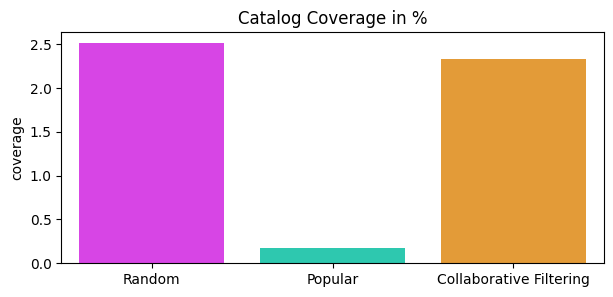

In [84]:
fig = plt.figure(figsize=(7, 3))
model_names = ['Random', 'Popular', 'Collaborative Filtering']
print("COVERAGE PLOT")
recmetrics.coverage_plot([coverage_random, coverage_popular, coverage_cf], model_names)

As we can see, the coverage is indeed perfectly correct given that the popular is low, as it is supposed to be, and the random and collaborative filtering is way larger. 
In this case, the collaborative filtering is larger most probably due to the sampling we made. According to external experience, the larger the sampling, the larger the coverage for the random recommender. 

### Personalization

In [85]:
personalization_random = recmetrics.personalization(top_n_random_only_items)
print(personalization_random)

0.8716578514085447


In [86]:
personalization_popular = recmetrics.personalization(top_n_popular_only_items)
print(personalization_popular)

0.0002174976253562777


In [87]:
personalization_cf = recmetrics.personalization(top_n_cf_only_items)
print(personalization_cf)

0.5188195979673941


PERSONALIZATION PLOT


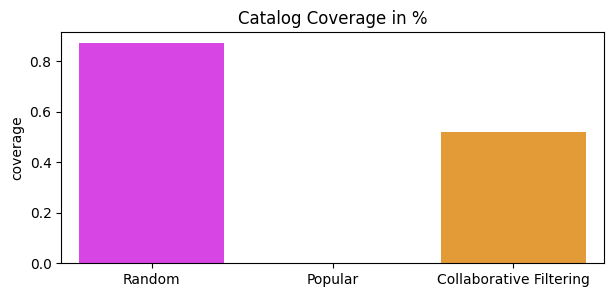

In [88]:
fig = plt.figure(figsize=(7, 3))
model_names = ['Random', 'Popular', 'Collaborative Filtering']
print("PERSONALIZATION PLOT")
recmetrics.coverage_plot([personalization_random, personalization_popular, personalization_cf], model_names)

This is good!

### Diversity

For Diversity I got 1% of the data, rather than 5% as for the rest, as it was taking a lot of time, being very computionally demanding

In [68]:
merged_df = pd.merge(sampled_reviews_df, books_df, on='book_id', how='inner')
merged_df['genres'] = merged_df['genres'].apply(lambda x: list(ast.literal_eval(x).keys()))
df_genres_m = merged_df.explode('genres')

In [69]:
merged_df_genres = df_genres_m[['book_id']].join(df_genres_m['genres'].str.get_dummies()).set_index('book_id')
merged_df_genres.head()

,children,"comics, graphic","fantasy, paranormal",fiction,"history, historical fiction, biography","mystery, thriller, crime",non-fiction,poetry,romance,young-adult
book_id,,,,,,,,,,
14742503,0,0,1,0,0,0,0,0,0,0
14742503,0,0,0,0,0,0,0,0,0,1
14742503,0,0,0,0,0,0,0,0,1,0
14742503,0,0,0,1,0,0,0,0,0,0
14742503,0,0,1,0,0,0,0,0,0,0


In [70]:
diversity_random = recmetrics.intra_list_similarity(top_n_random_only_items, merged_df_genres)
print(diversity_random)

0.20671817194106754


In [71]:
diversity_popular = recmetrics.intra_list_similarity(top_n_popular_only_items, merged_df_genres)
print(diversity_popular)

0.20704486094210436


In [72]:
diversity_cf = recmetrics.intra_list_similarity(top_n_cf_only_items, merged_df_genres)
print(diversity_cf)

0.19911822256700382


DIVERSITY PLOT


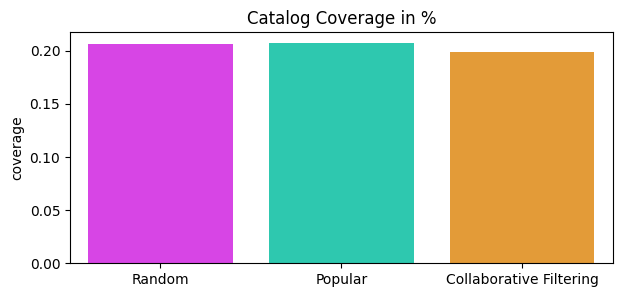

In [73]:
fig = plt.figure(figsize=(7, 3))
model_names = ['Random', 'Popular', 'Collaborative Filtering']
print("DIVERSITY PLOT")
recmetrics.coverage_plot([diversity_random, diversity_popular, diversity_cf], model_names)

#### Summary Plot

In [89]:
print("SUMMARY PLOT")
recmetrics.metrics_plot(model_names=['Random Recommender', 'Popular Recommender', 'Collaborative Recommender'],
                        coverage_scores=[coverage_random, coverage_popular, coverage_cf],
                        personalization_scores=[personalization_random, personalization_popular, personalization_cf],
                        intra_list_similarity_scores = [diversity_random, diversity_popular, diversity_cf])

SUMMARY PLOT


## Collaborative Filtering Model

In [3]:
# Filter the DataFrame to include only users with more than 20 ratings
users_with_more_than_20_ratings = reviews_df['user_id'].value_counts()[reviews_df['user_id'].value_counts() > 20].index
reviews_df_filtered = reviews_df[reviews_df['user_id'].isin(users_with_more_than_20_ratings)]
reviews_df_filtered.reset_index(drop=True, inplace=True)
reviews_df_filtered.shape[0]

243886

In [4]:
reader = Reader(rating_scale=(0, 5))
data = Dataset.load_from_df(reviews_df_filtered[['user_id', 'book_id', 'rating']], reader)

In [5]:
trainset, testset = train_test_split(data, test_size=.20, random_state=my_seed)

In [6]:
import random

random.seed(my_seed)
np.random.seed(my_seed)

### User Based

In [10]:
from surprise import KNNBasic, KNNWithMeans, KNNWithZScore, KNNBaseline, accuracy
from surprise.model_selection import cross_validate

algorithms = [KNNBasic, KNNWithMeans, KNNWithZScore, KNNBaseline]

In [11]:
# User based

user_based_results = []

for algo in algorithms:
    algorithm = algo(sim_options={'user_based': True})

    cv_results = cross_validate(algorithm, data, measures=['RMSE', 'MAE', 'FCP'], cv=5, verbose=False)

    mean_rmse = cv_results['test_rmse'].mean()
    mean_mae = cv_results['test_mae'].mean()
    mean_fcp = cv_results['test_fcp'].mean()

    user_based_results.append({
        'Algorithm': algorithm.__class__.__name__,
        'RMSE': mean_rmse,
        'MAE': mean_mae,
        'FCP': mean_fcp
    })

user_based_results_df = pd.DataFrame(user_based_results)
user_based_results_df.sort_values('RMSE', ascending=False, inplace=True)
user_based_results_df

Computing the msd similarity matrix...
Done computing similarity matrix.
Computing the msd similarity matrix...
Done computing similarity matrix.
Computing the msd similarity matrix...
Done computing similarity matrix.
Computing the msd similarity matrix...
Done computing similarity matrix.
Computing the msd similarity matrix...
Done computing similarity matrix.
Computing the msd similarity matrix...
Done computing similarity matrix.
Computing the msd similarity matrix...
Done computing similarity matrix.
Computing the msd similarity matrix...
Done computing similarity matrix.
Computing the msd similarity matrix...
Done computing similarity matrix.
Computing the msd similarity matrix...
Done computing similarity matrix.
Computing the msd similarity matrix...
Done computing similarity matrix.
Computing the msd similarity matrix...
Done computing similarity matrix.
Computing the msd similarity matrix...
Done computing similarity matrix.
Computing the msd similarity matrix...
Done computi

,Algorithm,RMSE,MAE,FCP
0,KNNBasic,1.175854,0.876367,0.604746
2,KNNWithZScore,1.091760,0.810982,0.600947
1,KNNWithMeans,1.090845,0.816069,0.602398
3,KNNBaseline,1.080595,0.807967,0.610612


### Item Based

In [12]:
# Item based

item_based_results = []

for algo in algorithms:
    algorithm = algo(sim_options={'user_based': False})

    cv_results = cross_validate(algorithm, data, measures=['RMSE', 'MAE', 'FCP'], cv=5, verbose=False)

    mean_rmse = cv_results['test_rmse'].mean()
    mean_mae = cv_results['test_mae'].mean()
    mean_fcp = cv_results['test_fcp'].mean()

    item_based_results.append({
        'Algorithm': algorithm.__class__.__name__,
        'RMSE': mean_rmse,
        'MAE': mean_mae,
        'FCP': mean_fcp
    })

item_based_results_df = pd.DataFrame(item_based_results)
item_based_results_df.sort_values('RMSE', ascending=False, inplace=True)
item_based_results_df

Computing the msd similarity matrix...
Done computing similarity matrix.
Computing the msd similarity matrix...
Done computing similarity matrix.
Computing the msd similarity matrix...
Done computing similarity matrix.
Computing the msd similarity matrix...
Done computing similarity matrix.
Computing the msd similarity matrix...
Done computing similarity matrix.
Computing the msd similarity matrix...
Done computing similarity matrix.
Computing the msd similarity matrix...
Done computing similarity matrix.
Computing the msd similarity matrix...
Done computing similarity matrix.
Computing the msd similarity matrix...
Done computing similarity matrix.
Computing the msd similarity matrix...
Done computing similarity matrix.
Computing the msd similarity matrix...
Done computing similarity matrix.
Computing the msd similarity matrix...
Done computing similarity matrix.
Computing the msd similarity matrix...
Done computing similarity matrix.
Computing the msd similarity matrix...
Done computi

,Algorithm,RMSE,MAE,FCP
0,KNNBasic,1.120210,0.844710,0.522771
2,KNNWithZScore,1.111750,0.827612,0.595684
1,KNNWithMeans,1.104907,0.824570,0.597562
3,KNNBaseline,1.065481,0.794993,0.600157


### Model Based

In [11]:
from surprise import SVD, SVDpp, NMF, CoClustering

algorithms_model = [SVD, SVDpp, NMF, CoClustering]
model_based_results = []

for algo in algorithms_model:
    algorithm = algo()

    cv_results = cross_validate(algorithm, data, measures=['RMSE', 'MAE', 'FCP'], cv=5, verbose=False)

    mean_rmse = cv_results['test_rmse'].mean()
    mean_mae = cv_results['test_mae'].mean()
    mean_fcp = cv_results['test_fcp'].mean()

    model_based_results.append({
        'Algorithm': algorithm.__class__.__name__,
        'RMSE': mean_rmse,
        'MAE': mean_mae,
        'FCP': mean_fcp
    })

model_based_results_df = pd.DataFrame(model_based_results)
model_based_results_df.sort_values(by='RMSE', ascending=True, inplace=True)

model_based_results_df

,Algorithm,RMSE,MAE,FCP
0,SVD,1.064917,0.800348,0.589119
1,SVDpp,1.068395,0.798439,0.591864
3,CoClustering,1.115632,0.833799,0.589816
2,NMF,1.140843,0.858941,0.589862


The SVD for the model based seems to be better compared to the user based, and a bit better than the item based with the KNN Baseline. 

Let's continue with the model based then!

#### Hyper parameter tuning of best model

In [12]:
n_factors_list = [1, 100, 1000]
n_factors_tuning_results = []

trainset, testset = train_test_split(data, test_size=0.25, random_state=42)

for n_factors in n_factors_list:
    algorithm = SVD(n_factors=n_factors)
    algorithm.fit(trainset)
    predictions = algorithm.test(testset)

    n_factors_rmse = accuracy.rmse(predictions, verbose=False)
    n_factors_mae = accuracy.mae(predictions, verbose=False)
    n_factors_fcp = accuracy.fcp(predictions, verbose=False)

    n_factors_tuning_results.append({
        'n_factors': n_factors,
        'RMSE': n_factors_rmse,
        'MAE': n_factors_mae,
        'FCP': n_factors_fcp
    })

n_factors_tuning_results_df = pd.DataFrame(n_factors_tuning_results)
n_factors_tuning_results_df.sort_values(by='RMSE', ascending=True, inplace=True)
n_factors_tuning_results_df

,n_factors,RMSE,MAE,FCP
0,1,1.053726,0.791921,0.621274
1,100,1.068019,0.803809,0.597915
2,1000,1.105112,0.840106,0.578111


In [13]:
epoch_list = [1, 10, 50]
epoch_tuning_results = []

for epochs in epoch_list:
    algorithm = SVD(n_epochs=epochs)

    algorithm.fit(trainset)

    predictions = algorithm.test(testset)

    epoch_rmse = accuracy.rmse(predictions, verbose=False)
    epoch_mae = accuracy.mae(predictions, verbose=False)
    epoch_fcp = accuracy.fcp(predictions, verbose=False)

    epoch_tuning_results.append({
        'n_epochs': epochs,
        'RMSE': epoch_rmse,
        'MAE': epoch_mae,
        'FCP': epoch_fcp
    })

epoch_tuning_results_df = pd.DataFrame(epoch_tuning_results)

epoch_tuning_results_df.sort_values(by='RMSE', ascending=True, inplace=True)

epoch_tuning_results_df

,n_epochs,RMSE,MAE,FCP
1,10,1.064464,0.805086,0.606185
2,50,1.107645,0.831159,0.578705
0,1,1.136578,0.873813,0.574054


In [14]:
learning_rates = [0.0001, 0.005, 0.1]
learning_rate_tuning_results = []

for lr in learning_rates:
    algorithm = SVD(lr_all=lr)

    algorithm.fit(trainset)

    predictions = algorithm.test(testset)

    lr_rmse = accuracy.rmse(predictions, verbose=False)
    lr_mae = accuracy.mae(predictions, verbose=False)
    lr_fcp = accuracy.fcp(predictions, verbose=False)

    learning_rate_tuning_results.append({
        'lr_all': lr,
        'RMSE': lr_rmse,
        'MAE': lr_mae,
        'FCP': lr_fcp
    })

learning_rate_tuning_results_df = pd.DataFrame(learning_rate_tuning_results)

learning_rate_tuning_results_df.sort_values(by='RMSE', ascending=True, inplace=True)

learning_rate_tuning_results_df

,lr_all,RMSE,MAE,FCP
1,0.0050,1.068205,0.803144,0.596561
2,0.1000,1.110607,0.834358,0.585421
0,0.0001,1.171944,0.908232,0.546589


In [15]:
regularization_values = [0, 0.02, 0.1]
regularization_tuning_results = []

for reg in regularization_values:
    algorithm = SVD(reg_all=reg)

    algorithm.fit(trainset)

    predictions = algorithm.test(testset)

    reg_rmse = accuracy.rmse(predictions, verbose=False)
    reg_mae = accuracy.mae(predictions, verbose=False)
    reg_fcp = accuracy.fcp(predictions, verbose=False)

    regularization_tuning_results.append({
        'reg_all': reg,
        'RMSE': reg_rmse,
        'MAE': reg_mae,
        'FCP': reg_fcp
    })

regularization_tuning_results_df = pd.DataFrame(regularization_tuning_results)

regularization_tuning_results_df.sort_values(by='RMSE', ascending=True, inplace=True)

regularization_tuning_results_df

,reg_all,RMSE,MAE,FCP
2,0.10,1.056332,0.797449,0.618593
1,0.02,1.066515,0.802419,0.602094
0,0.00,1.085742,0.816365,0.579478


In [14]:
# Final model (without tuning, just estimated parameters based on the extreme cases)

n_factors = 1
n_epochs = 10
lr_all = 0.0050
reg_all = 0.1

algorithm = SVD(n_factors=n_factors, n_epochs=n_epochs, lr_all=lr_all, reg_all=reg_all)

algorithm.fit(trainset)

predictions = algorithm.test(testset)

final_rmse = accuracy.rmse(predictions, verbose=True)
final_mae = accuracy.mae(predictions, verbose=True)
final_fcp = accuracy.fcp(predictions, verbose=True)

final_results = {
    'n_factors': n_factors,
    'n_epochs': n_epochs,
    'lr_all': lr_all,
    'reg_all': reg_all,
    'RMSE': final_rmse,
    'MAE': final_mae,
    'FCP': final_fcp
}

final_results_df = pd.DataFrame([final_results])

final_results_df

RMSE: 1.0870
MAE:  0.8335
FCP:  0.5784


,n_factors,n_epochs,lr_all,reg_all,RMSE,MAE,FCP
0,1,10,0.005,0.1,1.086974,0.833463,0.578355


It seems as if the SVD model with the base parameters is better. However let's compute a GridSearchCV to actually get the best parameters with the best accuracy.

FOR THE SVD MODEL

In [7]:
from surprise.model_selection import GridSearchCV

# Define parameter grid with more possibilities and additional parameters
param_grid = {'n_factors': [1, 2, 5, 10, 15, 20],
              'n_epochs': [5, 10, 15, 20, 25, 30],
              'lr_all': [0.002, 0.005, 0.01, 0.015, 0.02],
              'reg_all': [0.02, 0.1, 0.2, 0.3, 0.4]}


# Perform grid search
gs = GridSearchCV(SVD, param_grid, measures=['rmse', 'mae', 'fcp'], cv=3)
gs.fit(data)

# Get best parameters and results
best_params = gs.best_params['rmse']
best_rmse = gs.best_score['rmse']

# Print best parameters and results
print("Best Parameters (RMSE): ", best_params)
print("Best RMSE: ", best_rmse)

# Train SVD with best parameters on trainset
algorithm = SVD(**best_params)
algorithm.fit(trainset)

# Test the trained model on testset
predictions = algorithm.test(testset)

# Compute evaluation metrics
final_rmse = accuracy.rmse(predictions, verbose=True)
final_mae = accuracy.mae(predictions, verbose=True)
final_fcp = accuracy.fcp(predictions, verbose=True)

# Create final results dictionary
final_results = {
    'n_factors': best_params['n_factors'],
    'n_epochs': best_params['n_epochs'],
    'lr_all': best_params['lr_all'],
    'reg_all': best_params['reg_all'],
    'RMSE': final_rmse,
    'MAE': final_mae,
    'FCP': final_fcp
}

# Convert results to DataFrame
final_results_df_svd = pd.DataFrame([final_results])

# Display final results
print(final_results_df_svd)

Best Parameters (RMSE):  {'n_factors': 1, 'n_epochs': 20, 'lr_all': 0.005, 'reg_all': 0.02}
Best RMSE:  1.0531098583104808
RMSE: 1.0529
MAE:  0.7894
FCP:  0.6146
   n_factors  n_epochs  lr_all  reg_all      RMSE       MAE       FCP
0          1        20   0.005     0.02  1.052887  0.789427  0.614645


In [8]:
final_results_df_svd

,n_factors,n_epochs,lr_all,reg_all,RMSE,MAE,FCP
0,1,20,0.005,0.02,1.052887,0.789427,0.614645


FOR THE KNNBASELINE MODEL

In [9]:
from surprise.model_selection import GridSearchCV
from surprise import KNNBaseline
from surprise import accuracy

# Define parameter grid with more possibilities and additional parameters
param_grid = {'bsl_options': {'method': ['als', 'sgd'],
                              'reg': [1, 2, 5, 10, 15, 20]},
              'sim_options': {'name': ['pearson_baseline'],
                              'user_based': [False]}}

# Perform grid search
gs = GridSearchCV(KNNBaseline, param_grid, measures=['rmse', 'mae', 'fcp'], cv=3)
gs.fit(data)

# Get best parameters and results
best_params = gs.best_params['rmse']
best_rmse = gs.best_score['rmse']

# Print best parameters and results
print("Best Parameters (RMSE): ", best_params)
print("Best RMSE: ", best_rmse)

# Train KNNBaseline with best parameters on trainset
algorithm = KNNBaseline(**best_params)
algorithm.fit(trainset)

# Test the trained model on testset
predictions = algorithm.test(testset)

# Compute evaluation metrics
final_rmse = accuracy.rmse(predictions, verbose=True)
final_mae = accuracy.mae(predictions, verbose=True)
final_fcp = accuracy.fcp(predictions, verbose=True)

# Create final results dictionary
final_results = {
    'bsl_method': best_params['bsl_options']['method'],
    'bsl_reg': best_params['bsl_options']['reg'],
    'sim_name': best_params['sim_options']['name'],
    'user_based': best_params['sim_options']['user_based'],
    'RMSE': final_rmse,
    'MAE': final_mae,
    'FCP': final_fcp
}

# Convert results to DataFrame
final_results_df_knn = pd.DataFrame([final_results])

# Display final results
print(final_results_df_knn)


Estimating biases using als...
Computing the pearson_baseline similarity matrix...
Done computing similarity matrix.
Estimating biases using als...
Computing the pearson_baseline similarity matrix...
Done computing similarity matrix.
Estimating biases using als...
Computing the pearson_baseline similarity matrix...
Done computing similarity matrix.
Estimating biases using als...
Computing the pearson_baseline similarity matrix...
Done computing similarity matrix.
Estimating biases using als...
Computing the pearson_baseline similarity matrix...
Done computing similarity matrix.
Estimating biases using als...
Computing the pearson_baseline similarity matrix...
Done computing similarity matrix.
Estimating biases using als...
Computing the pearson_baseline similarity matrix...
Done computing similarity matrix.
Estimating biases using als...
Computing the pearson_baseline similarity matrix...
Done computing similarity matrix.
Estimating biases using als...
Computing the pearson_baseline si

In [11]:
final_results_df_knn["RMSE"]

0    1.090209
Name: RMSE, dtype: float64

In [12]:
final_results_df_svd["RMSE"]

0    1.052887
Name: RMSE, dtype: float64

It seems as if the best model is the SVD model!

Let's analyse more in-depth the SVD model

In [13]:
n_factors = 1
n_epochs = 20
lr_all = 0.005
reg_all = 0.02


algo = SVD(n_factors=n_factors, n_epochs=n_epochs, lr_all=lr_all, reg_all=reg_all)
algo.fit(trainset)

In [14]:
predictions = algo.test(testset)

In [15]:
accuracy.rmse(predictions);
accuracy.mae(predictions);

RMSE: 1.0528
MAE:  0.7892


In [16]:
performance = cross_validate(algo, data, measures=['RMSE', 'MAE'],
                             cv=KFold(n_splits=5, random_state=my_seed),
                             return_train_measures=True, verbose=True, n_jobs=-1)

Evaluating RMSE, MAE of algorithm SVD on 5 split(s).

                  Fold 1  Fold 2  Fold 3  Fold 4  Fold 5  Mean    Std     
RMSE (testset)    1.0457  1.0557  1.0487  1.0429  1.0527  1.0491  0.0046  
MAE (testset)     0.7859  0.7912  0.7871  0.7860  0.7893  0.7879  0.0021  
RMSE (trainset)   0.9915  0.9889  0.9900  0.9905  0.9889  0.9900  0.0010  
MAE (trainset)    0.7445  0.7428  0.7444  0.7441  0.7437  0.7439  0.0006  
Fit time          0.17    0.17    0.17    0.17    0.17    0.17    0.00    
Test time         0.11    0.12    0.11    0.11    0.11    0.11    0.00    


In [17]:
np.mean(performance['test_rmse'])

1.0491344128313442

In [18]:
np.mean(performance['train_rmse'])

0.9899693756944183

From what we can see above, the RMSE is quite low, given that it is around 1 with a standard deviation of 0.0039 in the test set. The difference between the RMSE for the test and train is actually lower than 0.3, which means that there isn't much overfitting, or books that only appear in the test/train set.

In [19]:
length_bool = len(testset) == len(predictions)
f"Are there as many predictions as ratings in the testset? {length_bool}"

'Are there as many predictions as ratings in the testset? True'

In [20]:
predictions[0:5]

[Prediction(uid='5cca1dd30cd5a98c1c8e731839265ccf', iid=2954411, r_ui=4.0, est=3.532165400643333, details={'was_impossible': False}),
 Prediction(uid='2e6d214902d16f63c781a6262f2aaccd', iid=12578305, r_ui=4.0, est=3.378125794358766, details={'was_impossible': False}),
 Prediction(uid='ac1f8cb05733d765da3f7b2f30677cbf', iid=11043618, r_ui=4.0, est=3.2540779290904447, details={'was_impossible': False}),
 Prediction(uid='fb1ba244d692fc877bf19d1bf29f893a', iid=9266794, r_ui=4.0, est=4.353957628936401, details={'was_impossible': False}),
 Prediction(uid='de7d29c9c5447ee23838856f733b415f', iid=11614718, r_ui=5.0, est=3.535159487176072, details={'was_impossible': False})]

In [21]:
uid = 'd94b47c0efb5d0c0f16cb2c179d972ef'
iid = 20643396

pred = algo.predict(uid, iid, r_ui=5, verbose=True)

user: d94b47c0efb5d0c0f16cb2c179d972ef item: 20643396   r_ui = 5.00   est = 3.43   {'was_impossible': False}


In [22]:
uid = 'd94b47c0efb5d0c0f16cb2c179d972ef'
given_user_df = reviews_df[reviews_df['user_id'] == uid].sort_values(by='rating', ascending=False)
given_user_df.head()

,user_id,book_id,review_id,rating,review_text,date_added,read_at,n_votes
188134,d94b47c0efb5d0c0f16cb2c179d972ef,24465809,29eb945acbae67adcb84de6b37437bb8,5,"Finalmente, llegamos a la ultima entrega de es...",Thu Aug 04 07:27:47 -0700 2016,Wed Aug 31 00:00:00 -0700 2016,0
188138,d94b47c0efb5d0c0f16cb2c179d972ef,10898880,8ee706234ff2fc0100bd99b5b956c135,5,La verdad es que el libro me gusto bastante en...,Mon Apr 27 14:00:28 -0700 2015,Tue Apr 28 00:00:00 -0700 2015,0
188148,d94b47c0efb5d0c0f16cb2c179d972ef,22812061,5c2e198f43ba888c5bade63752d71456,5,Debo decir que la novela es cautivadora y se n...,Thu Oct 09 09:45:13 -0700 2014,Thu Oct 16 14:10:33 -0700 2014,0
188142,d94b47c0efb5d0c0f16cb2c179d972ef,18224374,1d0aee60b85634427131f6cc5fe9f111,5,** spoiler alert ** \n ?Que puedo no decir de ...,Wed Nov 26 06:58:45 -0800 2014,Sun Nov 30 00:00:00 -0800 2014,0
188135,d94b47c0efb5d0c0f16cb2c179d972ef,24465599,13cbd94e43971b4fc95572ee96238fdd,4,"En esta entrega de los libros de Rick Riordan,...",Sun Jul 31 10:54:53 -0700 2016,Thu Aug 04 00:00:00 -0700 2016,0


In [23]:
already_rated = given_user_df['book_id'].unique()
all_items = reviews_df['book_id'].unique()
items_to_rate = [x for x in all_items if x not in already_rated]

In [24]:
all_predictions = {}
for iid in items_to_rate:
  est = algo.predict(uid, iid).est
  all_predictions[iid] = est

In [25]:
pred_df = pd.DataFrame([(x.r_ui, x.est) for x in predictions],
                       columns=['true_rating', 'predicted_rating'])
pred_df.head()

,true_rating,predicted_rating
0,4.0,3.532165
1,4.0,3.378126
2,4.0,3.254078
3,4.0,4.353958
4,5.0,3.535159


What we can infere from aboe is that the predicted rating is mostly around the mean, even when the true ratings are 2.0 (being the predicted ratings > 3.5 on average).

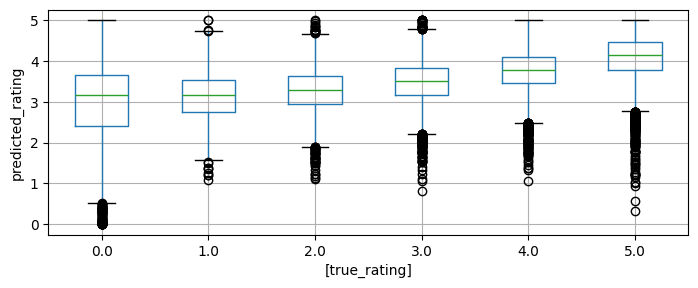

In [26]:
fig, ax = plt.subplots(figsize=(8,3))
bp = pred_df.boxplot(by="true_rating", ax=ax);

# Just aesthetic to format title and axis
bp.get_figure().suptitle('');
bp.get_figure().gca().set_title("");
bp.set_ylabel('predicted_rating');

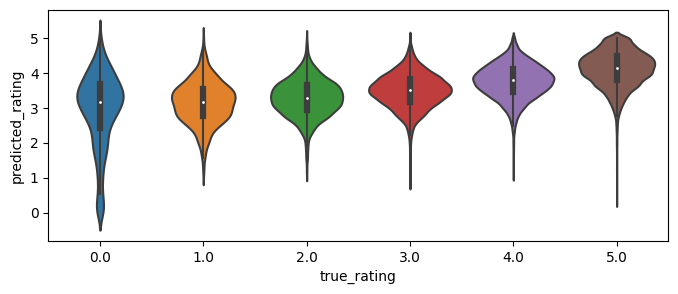

In [27]:
fig, ax = plt.subplots(figsize=(8,3))
sns.violinplot(data=pred_df, x="true_rating", y="predicted_rating");

We can see that our collaborative filtering model is not performing that well when it comes to extremes. Precisely, for ratings 0 the predicted rating range goes from extreme to extreme (0-5), and the closer to 2-4 teh better it performs.

In [30]:
mean = reviews_df_filtered['rating'].mean()
std = reviews_df_filtered['rating'].std()
print(f'The ratings mean is {round(mean, 2)} and std is {round(std, 4)}')

The ratings mean is 3.71 and std is 1.214


In [31]:
predictions_mean = [Prediction(uid, iid, r_ui, mean, {}) for uid, iid, r_ui in
                    reviews_df_filtered[['user_id', 'book_id', 'rating']].itertuples(index=False, name=None)]
accuracy.rmse(predictions_mean);

RMSE: 1.2140


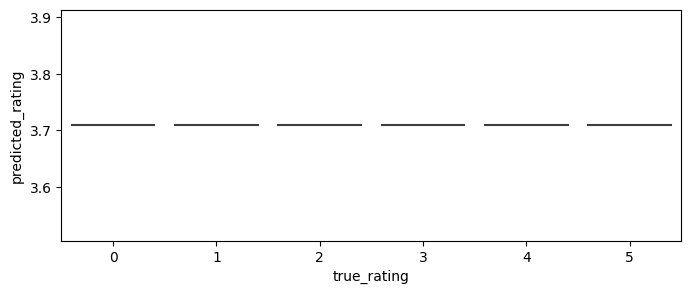

In [32]:
pred_mean_df = pd.DataFrame([(x.r_ui, x.est) for x in predictions_mean],
                            columns=['true_rating', 'predicted_rating'])

fig, ax = plt.subplots(figsize=(8,3))
sns.violinplot(data=pred_mean_df, x="true_rating", y="predicted_rating");

As it can be seen the naive recommender just gives the same value to all true ratings it being the aorund 3.75 (the mean)

Let's control OVERFITTING!

In [33]:
rmse_train_dict = {}
rmse_test_dict = {}
fit_time_dict = {}

for n in tqdm(range(1, 500, 10)):
  algo = NMF(n_factors=10, n_epochs=n, random_state=my_seed)
  performance = cross_validate(algo, data, measures=['RMSE'],
                               cv=KFold(n_splits=4, random_state=my_seed),
                               return_train_measures=True, verbose=False, n_jobs=-1)
  rmse_test_dict[n] = np.mean(performance['test_rmse'])
  rmse_train_dict[n] = np.mean(performance['train_rmse'])
  fit_time_dict[n] = np.mean(performance['fit_time'])

  0%|          | 0/50 [00:00<?, ?it/s]/Users/pablochamorro/Desktop/Coding/Chamorro.venv/lib/python3.12/site-packages/joblib/externals/loky/process_executor.py:752: UserWarning: A worker stopped while some jobs were given to the executor. This can be caused by a too short worker timeout or by a memory leak.
  warnings.warn(
100%|██████████| 50/50 [05:25<00:00,  6.51s/it]


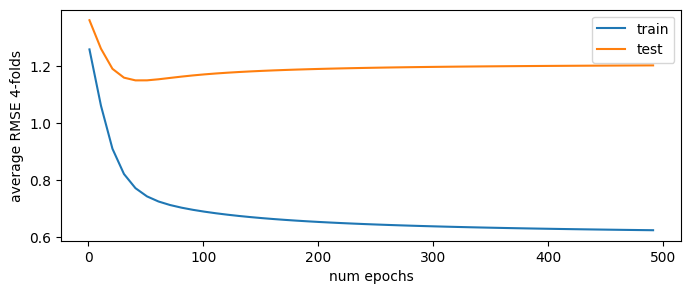

In [34]:
plt.subplots(figsize=(8,3))
plt.plot(rmse_train_dict.keys(), rmse_train_dict.values(), label='train');
plt.plot(rmse_test_dict.keys(), rmse_test_dict.values(), label='test');
plt.xlabel('num epochs');
plt.ylabel('average RMSE 4-folds');
plt.legend();

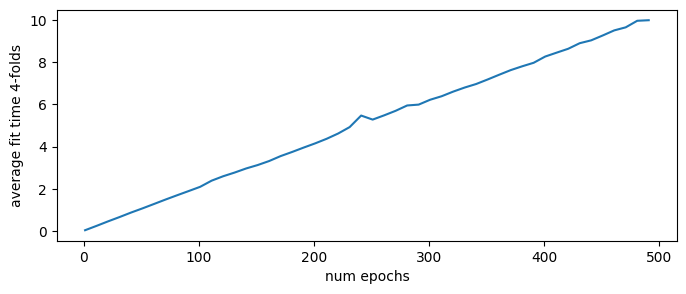

In [35]:
plt.subplots(figsize=(8,3))
plt.plot(fit_time_dict.keys(), fit_time_dict.values());
plt.xlabel('num epochs');
plt.ylabel('average fit time 4-folds');

As it can be seen from the plot, the number of epochs that makes a difference when reducing the RMSE is around 30, as after 35-40 the reducement in the test set is almost non-noticeable.

In [36]:
rmse_train_dict = {}
rmse_test_dict = {}
fit_time_dict = {}

# This takes ~5 min to run
# tqdm library allows to make verbose a loop
for n in tqdm(range(1, 500, 20)):
  # Let's reduce n_factors to speed up the execution
  algo = NMF(n_factors=100, n_epochs=n, random_state=my_seed)
  performance = cross_validate(algo, data, measures=['RMSE'],
                               cv=KFold(n_splits=4, random_state=my_seed),
                               return_train_measures=True, verbose=False, n_jobs=-1)
  rmse_test_dict[n] = np.mean(performance['test_rmse'])
  rmse_train_dict[n] = np.mean(performance['train_rmse'])
  fit_time_dict[n] = np.mean(performance['fit_time'])

100%|██████████| 25/25 [13:18<00:00, 31.95s/it]


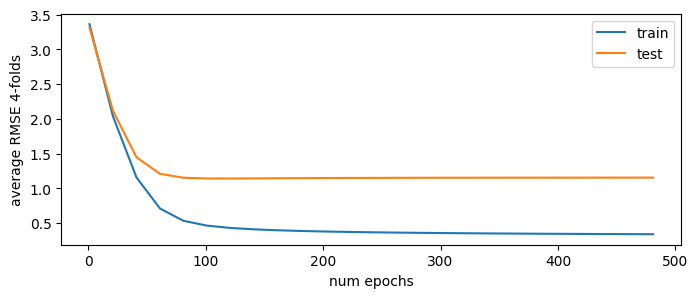

In [37]:
plt.subplots(figsize=(8,3))
plt.plot(rmse_train_dict.keys(), rmse_train_dict.values(), label='train');
plt.plot(rmse_test_dict.keys(), rmse_test_dict.values(), label='test');
plt.xlabel('num epochs');
plt.ylabel('average RMSE 4-folds');
plt.legend();

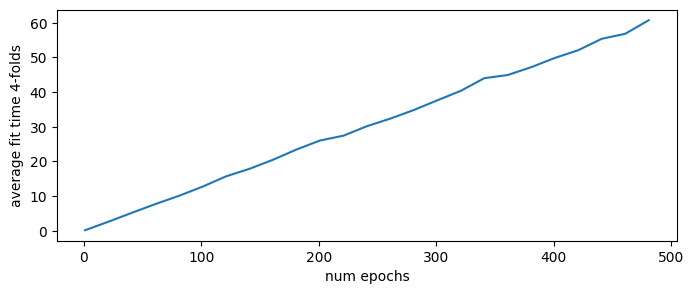

In [38]:
plt.subplots(figsize=(8,3))
plt.plot(fit_time_dict.keys(), fit_time_dict.values());
plt.xlabel('num epochs');
plt.ylabel('average fit time 4-folds');

FURTHER INTERPRETATION

In [39]:
algo = NMF(n_factors=2)
algo.fit(trainset)
print(algo.pu.shape)
print(algo.qi.shape)

(4174, 2)
(20417, 2)


In [40]:
algo = NMF(n_factors=15)
algo.fit(trainset)
print(algo.pu.shape)
print(algo.qi.shape)

(4174, 15)
(20417, 15)


In [41]:
algo = NMF(n_factors=50)
algo.fit(trainset)
print(algo.pu.shape)
print(algo.qi.shape)

(4174, 50)
(20417, 50)


In [42]:
rmse_test_dict = {}

# This takes ~5 min to run
# tqdm library allows to make verbose a loop
for n in tqdm(range(1, 80, 2)):
  # Let's reduce n_epochs to speed up the execution
  algo = NMF(n_factors=n, n_epochs=20, random_state=my_seed)
  performance = cross_validate(algo, data, measures=['RMSE'],
                               cv=KFold(n_splits=4, random_state=my_seed),
                               verbose=False, n_jobs=-1)
  rmse_test_dict[n] = np.mean(performance['test_rmse'])

100%|██████████| 40/40 [01:23<00:00,  2.09s/it]


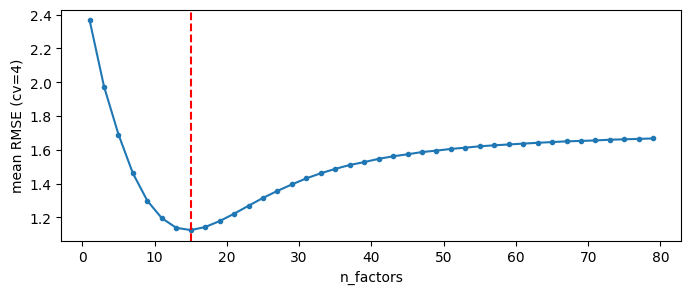

In [43]:
fig, ax = plt.subplots(figsize=(8,3))
plt.plot(rmse_test_dict.keys(), rmse_test_dict.values(), marker='.');
plt.axvline(x=min(rmse_test_dict, key=rmse_test_dict.get), color='red', linestyle='dashed')
plt.xlabel('n_factors');
plt.ylabel('mean RMSE (cv=4)');

Clearly, the best RMSE (lowest) is achieved with n_factors equal to 15, meaning that when there are 15 different number of factors explaining the recommendations, the more accurate the latter are.

**INTERPRETATION OF THE LATENT FACTORS**

In [42]:
all_df = reviews_df.merge(books_df, on='book_id')
data_title = Dataset.load_from_df(all_df[['user_id', 'title', 'rating']], reader)

In [43]:
# Let's use all data to train a SVDpp to increase a bit the performance
algo = SVDpp(n_factors=2, random_state=my_seed)
algo.fit(data_title.build_full_trainset());

In [44]:
names = [algo.trainset.to_raw_iid(x) for x in algo.trainset.all_items()]

In [45]:
df_aux = pd.DataFrame(zip(algo.qi.T[0], algo.qi.T[1], names))
fig = px.scatter(df_aux, x=0, y=1, hover_data=[2])
fig.show()

WHAT CAN WE INFERE FROM HERE? 

SVD n_factors!

In [72]:
rmse_test_dict_svd = {}
factors_range = range(1, 80, 2)

for n_factors in tqdm(factors_range):
    algo = SVD(n_factors=n_factors, n_epochs=20, random_state=my_seed)
    performance = cross_validate(algo, data, measures=['RMSE'],
                                cv=KFold(n_splits=4, random_state=my_seed),
                                verbose=False, n_jobs=-1)
    rmse_test_dict_svd[n_factors] = np.mean(performance['test_rmse'])

100%|██████████| 40/40 [01:23<00:00,  2.10s/it]


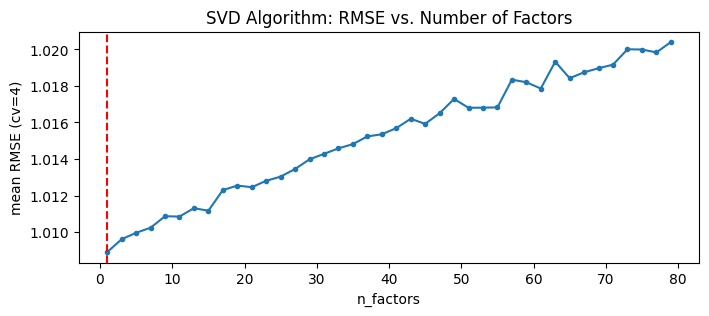

In [73]:
fig, ax = plt.subplots(figsize=(8,3))
plt.plot(rmse_test_dict_svd.keys(), rmse_test_dict_svd.values(), marker='.')
plt.axvline(x=min(rmse_test_dict_svd, key=rmse_test_dict_svd.get), color='red', linestyle='dashed')
plt.xlabel('n_factors')
plt.ylabel('mean RMSE (cv=4)')
plt.title('SVD Algorithm: RMSE vs. Number of Factors')
plt.show()

As it can be seen, actually the best RMSE is achieved by the SVD model with the number of factors = 1. Hence, we will create a collaborative filtering model with these parameters.

#### SVD NDCG vs tuned SVD NDCG

##### SVD baseline

In [44]:
algo = SVD(random_state=my_seed)

reader = Reader(rating_scale=(0.5, 5))

In [45]:
%%time
data = Dataset.load_from_df(reviews_df_filtered[['user_id', 'book_id', 'rating']], reader)

trainset, testset = train_test_split(data, test_size=.20, random_state=my_seed)

algo.fit(trainset);
predictions = algo.test(testset)
predictions_df = pd.DataFrame(predictions)

CPU times: user 1.37 s, sys: 1.58 s, total: 2.94 s
Wall time: 1.27 s


In [46]:
predictions_byuser_df = predictions_df.groupby('uid')[['iid', 'r_ui', 'est']].agg(lambda x: list(x))

predictions_byuser_df.head(2)

,iid,r_ui,est
uid,,,
001bcd168bef7b3789288dc60338697d,"[260037, 256683, 6368611, 11870085, 11808950, ...","[4.0, 4.0, 3.0, 5.0, 5.0, 5.0, 5.0]","[3.5268475037557607, 4.24383077205118, 4.06038..."
00254cd48d3d8a99ca9f0ed44fa69d5f,"[7807029, 8918253, 12588363, 9471670, 7146050,...","[5.0, 5.0, 4.0, 5.0, 5.0, 4.0, 5.0, 5.0, 5.0, ...","[4.50972393653448, 4.026042589902592, 3.819862..."


In [47]:
import sklearn.metrics as metrics

In [48]:
def ndcg_multiple_users(relevant_items_all_users, predictions_ranking_all_users, k=5):
    ndcg_list = []
    # Loop all users
    for i in range(len(relevant_items_all_users)):
      # Skip users with only 1 item in the test data, as no NDCG can be computed
      if len(relevant_items_all_users[i]) > 1:
        ndcg = metrics.ndcg_score([relevant_items_all_users[i]],
                                  [predictions_ranking_all_users[i]], k=k)
        ndcg_list.append(ndcg)

    return np.mean(ndcg_list)

In [49]:
ndcg_multiple_users(predictions_byuser_df['r_ui'].tolist(),
                    predictions_byuser_df['est'].tolist())

0.9021118268464822

##### SVD tuned

In [50]:
n_factors = 1
n_epochs = 20
lr_all = 0.005
reg_all = 0.02


algo = SVD(n_factors=n_factors, n_epochs=n_epochs, lr_all=lr_all, reg_all=reg_all)

reader = Reader(rating_scale=(0.5, 5))

In [51]:
%%time
data = Dataset.load_from_df(reviews_df_filtered[['user_id', 'book_id', 'rating']], reader)

trainset, testset = train_test_split(data, test_size=.20, random_state=my_seed)

algo.fit(trainset);
predictions = algo.test(testset)
predictions_df = pd.DataFrame(predictions)

CPU times: user 645 ms, sys: 5.16 ms, total: 650 ms
Wall time: 653 ms


In [52]:
predictions_byuser_df = predictions_df.groupby('uid')[['iid', 'r_ui', 'est']].agg(lambda x: list(x))

predictions_byuser_df.head(2)

,iid,r_ui,est
uid,,,
001bcd168bef7b3789288dc60338697d,"[260037, 256683, 6368611, 11870085, 11808950, ...","[4.0, 4.0, 3.0, 5.0, 5.0, 5.0, 5.0]","[3.6213113317094456, 3.847927533718043, 3.9319..."
00254cd48d3d8a99ca9f0ed44fa69d5f,"[7807029, 8918253, 12588363, 9471670, 7146050,...","[5.0, 5.0, 4.0, 5.0, 5.0, 4.0, 5.0, 5.0, 5.0, ...","[4.4754851825169215, 4.198422214820549, 3.9003..."


In [53]:
def ndcg_multiple_users(relevant_items_all_users, predictions_ranking_all_users, k=5):
    ndcg_list = []
    # Loop all users
    for i in range(len(relevant_items_all_users)):
      # Skip users with only 1 item in the test data, as no NDCG can be computed
      if len(relevant_items_all_users[i]) > 1:
        ndcg = metrics.ndcg_score([relevant_items_all_users[i]],
                                  [predictions_ranking_all_users[i]], k=k)
        ndcg_list.append(ndcg)

    return np.mean(ndcg_list)

In [54]:
ndcg_multiple_users(predictions_byuser_df['r_ui'].tolist(),
                    predictions_byuser_df['est'].tolist())

0.908014048471368

The improvement in NDCG is not that much, but it is definitely significant in real terms!

### Model Creation CF

After knowing that our best model is the SVD, we can now train the model with the whole dataset!

This model will get the **Top 10 best rated books** for a given user, and it will print the title of the book.

In [8]:
n_factors = 1
n_epochs = 20
lr_all = 0.005
reg_all = 0.02

collaborative_f_model = SVD(n_factors=n_factors, n_epochs=n_epochs, lr_all=lr_all, reg_all=reg_all)
collaborative_f_model.fit(trainset)

Let's pickle the model!

In [97]:
import pickle
from huggingface_hub import hf_hub_url, HfApi
import os

directory = "/Users/pablochamorro/Desktop/Coding/Recommendation Engines/project"

# Save the model using pickle
file_path = os.path.join(directory, "collaborative_filtering_model.pkl")
with open(file_path, "wb") as f:
    pickle.dump(collaborative_f_model, f)


In [7]:
all_df_filtered = reviews_df_filtered.merge(books_df, on='book_id')

In [9]:
def get_user_recommendations_CF(uid, df, n=10):
    user_items = df[df['user_id'] == uid]['book_id'].unique()  
    all_items = df['book_id'].unique()
    items_to_recommend = np.setdiff1d(all_items, user_items)

    predictions = []
    for iid in items_to_recommend:
        pred = collaborative_f_model.predict(uid, iid, verbose=False)
        predictions.append({'book_id': iid, 'prediction': pred.est})

    predictions.sort(key=lambda x: x['prediction'], reverse=True)
    top_10_recommendations = predictions[:10]
    top_10_titles = [df[df['book_id'] == pred['book_id']]['title'].iloc[0] for pred in top_10_recommendations]

    return top_10_titles, top_10_recommendations


In [10]:
user_id = 'd94b47c0efb5d0c0f16cb2c179d972ef'
n = 10
top_10_titles, top_10_recommendations = get_user_recommendations_CF(user_id, all_df_filtered, n)
for i, title in enumerate(top_10_titles, 1):
        print(f"{i}. {title}")

1. The King of Attolia (The Queen's Thief, #3)
2. Quintana of Charyn (Lumatere Chronicles, #3)
3. The Hate U Give
4. Aristotle and Dante Discover the Secrets of the Universe
5. Night of Cake & Puppets (Daughter of Smoke & Bone, #2.5)
6. Long Way Down
7. Wonder (Wonder #1)
8. Jellicoe Road
9. Okay for Now
10. Cress (The Lunar Chronicles, #3)


In [11]:
top_10_recommendations_df = pd.DataFrame(top_10_recommendations)
top_10_recommendations_df = top_10_recommendations_df.merge(books_df[['book_id', 'title']], on='book_id')
print(top_10_recommendations_df)

    book_id  prediction                                              title
0     40159    4.652821        The King of Attolia (The Queen's Thief, #3)
1  10165761    4.614078       Quintana of Charyn (Lumatere Chronicles, #3)
2  32075671    4.602612                                    The Hate U Give
3  15801353    4.576101  Aristotle and Dante Discover the Secrets of th...
4  18360128    4.563431  Night of Cake & Puppets (Daughter of Smoke & B...
5  22552026    4.556772                                      Long Way Down
6  11387515    4.551142                                 Wonder (Wonder #1)
7   7042434    4.527388                                      Jellicoe Road
8   9165406    4.510132                                       Okay for Now
9  21469054    4.495247                   Cress (The Lunar Chronicles, #3)


## Content-Based Model

In [5]:
from sentence_transformers import SentenceTransformer
from sklearn.metrics.pairwise import pairwise_distances
from sklearn.feature_extraction.text import CountVectorizer

We are going to sample the books, as the embeddings if not is extremely large, therefore getting the books with the highest number of reviews.

In [156]:
all_df = reviews_df.merge(books_df, on='book_id')

In [157]:
# Filter the DataFrame to include only users with more than 20 ratings
users_with_more_than_20_ratings = all_df['user_id'].value_counts()[all_df['user_id'].value_counts() > 20].index
top_books_df = all_df[all_df['user_id'].isin(users_with_more_than_20_ratings)]
top_books_df.reset_index(drop=True, inplace=True)
top_books_df.shape[0]

100138

In [158]:
top_books_ids = top_books_df['book_id'].unique()
filtered_books_df = books_df[books_df['book_id'].isin(top_books_ids)]
filtered_books_df.reset_index(drop=True, inplace=True)
filtered_books_df.shape[0]

15129

### BERT

In [8]:
model = SentenceTransformer('distilbert-base-nli-mean-tokens')
embeddings = model.encode(filtered_books_df['description'], show_progress_bar=False)

In [9]:
top_books_df['title'] = top_books_df['title'].str.strip().str.lower()
filtered_books_df['title'] = filtered_books_df['title'].str.strip().str.lower()

filtered_books_df.set_index('book_id', inplace=True)
top_books_df = top_books_df.reset_index().drop_duplicates(subset='book_id', keep='first').set_index('book_id')

/var/folders/k3/yvsb49212nx0rzv6l20v1gy00000gn/T/ipykernel_31446/342827560.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  top_books_df['title'] = top_books_df['title'].str.strip().str.lower()
/var/folders/k3/yvsb49212nx0rzv6l20v1gy00000gn/T/ipykernel_31446/342827560.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  filtered_books_df['title'] = filtered_books_df['title'].str.strip().str.lower()


In [10]:
embeddings_df = pd.DataFrame(embeddings)
embeddings_df.index = filtered_books_df.index
embeddings_df.head()

,0,1,2,3,4,5,6,7,8,9,...,758,759,760,761,762,763,764,765,766,767
book_id,,,,,,,,,,,,,,,,,,,,,
21401181,-0.634513,-0.803615,0.287022,-0.598381,-0.379536,-0.505996,0.087189,-0.623852,0.804649,0.856308,...,-0.277189,0.760712,0.033615,0.691138,-0.037560,-0.414531,-0.213930,-0.771974,0.150110,-0.696176
22642971,-0.261218,-0.283399,0.231602,-0.665426,-0.172117,-0.388628,0.151258,-0.455277,0.540079,0.535548,...,-0.545867,-0.476644,0.052030,0.515152,0.360673,-0.460168,0.109375,-0.153618,-0.270658,-0.639353
31556136,-0.444797,-0.514791,0.402787,-0.522840,0.021787,-0.706733,-0.155819,-0.619488,1.024557,0.654360,...,-0.013176,-1.021316,-0.262658,0.628414,0.471264,-0.119671,-0.250085,-0.563880,0.042421,-0.595361
25421507,-0.084384,-0.476873,0.418162,-0.642931,-0.264311,-0.203423,-0.590895,-0.759686,0.412812,0.325378,...,-1.052070,-0.107802,-0.293116,0.413719,0.109669,-0.391018,-0.255198,0.139713,0.190444,-0.484863
25414982,-0.347720,-0.441079,0.265948,-0.785311,-0.352077,-0.184086,-0.602574,-0.711446,0.496077,0.925610,...,-0.572019,-0.486802,0.118740,-0.102510,0.272351,-0.390310,-0.196216,-0.304366,-0.147151,-0.260448


In [11]:
print(embeddings_df.shape)

(22325, 768)


In [12]:
f'Each item is represented by {embeddings_df.shape[1]} words'

'Each item is represented by 768 words'

In [13]:
def compute_similarities(vectorization_df):
  sim = pairwise_distances(vectorization_df, vectorization_df, metric='cosine')
  sim_df = pd.DataFrame(sim, columns=filtered_books_df.index)
  sim_df.index = filtered_books_df.index
  return sim_df

In [14]:
bert_sim_df = compute_similarities(embeddings_df)

In [15]:
def top_n(sim_df, item, n):
    recommendations_df = filtered_books_df[['description']].copy()
    recommendations_df['distance'] = sim_df.loc[item]
    recommendations_df = recommendations_df.join(filtered_books_df[['title']])
    chosen_book_name = recommendations_df.loc[int(item), 'title']
    seen_titles = set()
    unique_recommendations = []
    
    for index, row in recommendations_df.iterrows():
        title = row['title']
        if title not in seen_titles:
            unique_recommendations.append(row)
            seen_titles.add(title)
    
    unique_recommendations = pd.DataFrame(unique_recommendations)
    unique_recommendations = unique_recommendations[~((unique_recommendations['title'] == chosen_book_name) & (unique_recommendations.index != int(item)))]
    unique_recommendations.drop(index=int(item), inplace=True, errors='ignore') # We drop it again, just in case! 
    unique_recommendations = unique_recommendations.sort_values('distance').head(n)
    
    return unique_recommendations


We have decided to delete those books that have the same title, as in many cases the book is the same with a different book_id. This happens because it has a different publisher, but the book itself is the same.

In [16]:
top_n(bert_sim_df, 17262776, 10)

,description,distance,title
7968682,Anna's bruised and upset by the collapse of he...,0.076909,he's after me
16243508,"Mina Grime is unlucky, unpopular and uncoordin...",0.080205,"unenchanted (an unfortunate fairy tale, #1)"
17586441,Kirsten has spent her life trying to forget. B...,0.084512,the merciful scar
22041877,Kelsie Sullivan's life has changed forever. Th...,0.086185,breaking free
30319089,It's what we do after the hurt that matters.\n...,0.089084,aftercare instructions
28755324,"Forced to return to his estranged family, John...",0.089737,the homecoming
25897851,"""Just let it go.""\nThat's what everyone keeps ...",0.090138,suffer love
394846,A brutal car accident that claimed the life of...,0.090454,the presence: a ghost story
26129325,"In this modern take on a holiday classic, high...",0.090879,a christmas kerril
10339088,"In October Breezes, Devin Abbott almost lost t...",0.091153,summer sunsets (october breezes #2)


#### BERT evaluation

We will evaluate the BERT model by taking one user, getting the the two best rated book he/she read, and getting the ranked books by distance. Then, we will compare it to the actual list, and compute the NDCG. 

In [30]:
user_id = '8e1db93d364acf3893ce998ebb8d57fc'

filtered_df = top_books_df[(top_books_df['user_id'] == user_id) & (top_books_df['rating'] == 5)]

# Sort the filtered DataFrame by 'read_at' column in descending order and get top 2
top_rated_books = filtered_df.sort_values(by='read_at', ascending=False).head(2)

# Extract the 'book_id' of top-rated books
top_book_ids = top_rated_books.index.tolist()
top_book_ids

[7171637, 8306857]

In [100]:
user_df = top_books_df[(top_books_df['user_id'] == user_id)]
user_df.loc[7171637]

index                                                           28116
user_id                              8e1db93d364acf3893ce998ebb8d57fc
review_id                            c97e36637b42ddf346a012640f1cc09f
rating                                                              5
review_text         It's a must read. If you're the type of person...
date_added                             Thu Jan 24 03:22:12 -0800 2013
read_at                                Tue Jan 29 04:12:27 -0800 2013
n_votes                                                             0
isbn                                                       1416975861
title                      clockwork angel (the infernal devices, #1)
average_rating                                                   4.33
publisher                     Simon & Schuster, Margaret K. McElderry
description         In a time when Shadowhunters are barely winnin...
series                                                     ['213230']
country_code        

In [151]:
def top_n_eval(sim_df, item, n):
  recommendations_df = user_df[['description', 'title']].copy()
  recommendations_df['distance'] = sim_df.loc[item]
  recommendations_df = recommendations_df.sort_values('distance').head(n)
  return recommendations_df

##### For item top 1

In [159]:
user_id = '8e1db93d364acf3893ce998ebb8d57fc'
item = 7171637

recommendations = top_n_eval(bert_sim_df, item, 23)
recommendations

,description,title,distance
book_id,,,
7171637,"In a time when Shadowhunters are barely winning the fight against the forces of darkness, one battle will change the course of history forever. Welcome to the Infernal Devices trilogy, a stunning ...","clockwork angel (the infernal devices, #1)",0.000000
6131164,"Danger and betrayal, secrets and enchantment in the breathtaking conclusion to the Infernal Devices trilogy.\nTessa Gray should be happy - aren't all brides happy?\nYet as she prepares for her wed...","clockwork princess (the infernal devices, #3)",0.120256
10025305,"In the magical underworld of Victorian London, Tessa Gray has at last found safety with the Shadowhunters. But that safety proves fleeting when rogue forces in the Clave plot to see her protector,...","clockwork prince (the infernal devices, #2)",0.139004
10662420,"When sweet revenge turns sour... Book two of a trilogy from New York Timesbestselling author Jenny Han and Siobhan Vivian.\nLillia, Kat, and Mary had the perfect plan. Work together in secret to t...","fire with fire (burn for burn, #2)",0.167898
12411635,"Sixteen-year-old Dusty Everhart breaks into houses late at night, but not because she's a criminal. No, she's a Nightmare.\nLiterally.\nBeing the only Nightmare at Arkwell Academy, a boarding scho...","the nightmare affair (the arkwell academy, #1)",0.172974
18705209,"Though the Greek and Roman crewmembers of the Argo IIhave made progress in their many quests, they still seem no closer to defeating the earth mother, Gaea. Her giants have risen--all of them--and...","the blood of olympus (the heroes of olympus, #5)",0.176752
9520360,"Seven half-bloods shall answer the call,\nTo storm or fire the world must fall.\nAn oath to keep with a final breath,\nAnd foes bear arms to the Doors of Death.\nPercy is confused.When he awoke fr...","the son of neptune (the heroes of olympus, #2)",0.182397
12127810,"At the conclusion of The Mark of Athena, Annabeth and Percy tumble into a pit leading straight to the Underworld. The other five demigods have to put aside their grief and follow Percy's instructi...","the house of hades (the heroes of olympus, #4)",0.189662
6567017,"Will Grayson meets Will Grayson. One cold night, in a most unlikely corner of Chicago, two strangers are about to cross paths. From that moment on, their world will collide and lives intertwine.\n...","will grayson, will grayson",0.211869


In [160]:
titles_in_recommendations = set(recommendations['title'])
titles_in_user_df = set(user_df['title'])
titles_match = titles_in_recommendations.issubset(titles_in_user_df)
f'Do all titles match? {titles_match}'

'Do all titles match? True'

In [161]:
def get_titles_ordered_by_rating(user_df):
    sorted_user_df = user_df.sort_values(by=['rating', 'read_at'], ascending=False)
    titles_ordered_by_rating = sorted_user_df['title']
    return titles_ordered_by_rating

titles_in_order = get_titles_ordered_by_rating(user_df)
titles_in_order_l = list(titles_in_order)

In [162]:
def get_ratings_ordered(user_df):
    sorted_user_df = user_df.sort_values(by=['rating', 'read_at'], ascending=False)
    titles_ordered_by_rating = sorted_user_df['rating']
    return titles_ordered_by_rating

ratings_in_order = get_ratings_ordered(user_df)
ratings_in_order_l = list(ratings_in_order)

In [163]:
recommendations['distance2'] = [1 - value for value in recommendations['distance']]

In [164]:
title_distance_mapping = recommendations.set_index('title')['distance2'].to_dict()
distances_in_order = [title_distance_mapping.get(title) for title in titles_in_order_l]
print(distances_in_order)

[1.0, 0.664400577545166, 0.8176026344299316, 0.7664821743965149, 0.7697300910949707, 0.7521359920501709, 0.7773842215538025, 0.7533859014511108, 0.7398717999458313, 0.7776381969451904, 0.8232482671737671, 0.8103376626968384, 0.8797435760498047, 0.8609964847564697, 0.6663220524787903, 0.8321024179458618, 0.7881306409835815, 0.7602994441986084, 0.8270255923271179, 0.7816466093063354, 0.7290408611297607, 0.6343228816986084, 0.7861144542694092]


In [165]:
from sklearn.metrics import ndcg_score

rankings_in_order_arr = np.array([ratings_in_order_l])
recommendations_arr = np.array([distances_in_order])

# Compute NDCG score
ndcg = ndcg_score(recommendations_arr, rankings_in_order_arr, k=len(recommendations_arr))
print("NDCG Score:", ndcg)


NDCG Score: 0.8036430954933167


##### For item top 2

In [152]:
user_id = '8e1db93d364acf3893ce998ebb8d57fc'
item = 8306857

recommendations = top_n_eval(bert_sim_df, item, 23)
recommendations

,description,title,distance
book_id,,,
8306857,"In Beatrice Prior's dystopian Chicago, society is divided into five factions, each dedicated to the cultivation of a particular virtue--Candor (the honest), Abnegation (the selfless), Dauntless (t...","divergent (divergent, #1)",0.000000
10798416,"Who would have guessed that four minutes could change everything?\nToday should be one of the worst days of seventeen-year-old Hadley Sullivan's life. Having missed her flight, she's stuck at JFK ...",the statistical probability of love at first sight,0.277512
5633958,"Heaven couldn't be a phone bank, could it?\nCharlotte Usher discovers that the afterlife isn't quite what she pictured when she's forced to intern at a hotline for troubled teens. Before she can o...","homecoming (ghostgirl, #2)",0.279721
6567017,"Will Grayson meets Will Grayson. One cold night, in a most unlikely corner of Chicago, two strangers are about to cross paths. From that moment on, their world will collide and lives intertwine.\n...","will grayson, will grayson",0.282960
14290364,He is a Legend.\nShe is a Prodigy.\nWho will be Champion?\nJune and Day have sacrificed so much for the people of the Republic--and each other--and now their country is on the brink of a new exist...,"champion (legend, #3)",0.283163
15837671,"Sixteen-year-old Aza never intended to pursue the mystery of fugitive billionaire Russell Pickett, but there's a hundred-thousand-dollar reward at stake and her Best and Most Fearless Friend, Dais...",turtles all the way down,0.283819
2767052,"Winning will make you famous.\nLosing means certain death.\nThe nation of Panem, formed from a post-apocalyptic North America, is a country that consists of a wealthy Capitol region surrounded by ...","the hunger games (the hunger games, #1)",0.292031
10662420,"When sweet revenge turns sour... Book two of a trilogy from New York Timesbestselling author Jenny Han and Siobhan Vivian.\nLillia, Kat, and Mary had the perfect plan. Work together in secret to t...","fire with fire (burn for burn, #2)",0.310949
13406425,"Postcard-perfect Jar Island is home to charming tourist shops, pristine beaches, amazing oceanfront homes--and three girls secretly plotting revenge.\nKAT is sick and tired of being bullied by her...","burn for burn (burn for burn, #1)",0.317163


In [153]:
titles_in_recommendations = set(recommendations['title'])
titles_in_user_df = set(user_df['title'])
titles_match = titles_in_recommendations.issubset(titles_in_user_df)
f'Do all titles match? {titles_match}'

'Do all titles match? True'

In [154]:
titles_in_order = get_titles_ordered_by_rating(user_df)
titles_in_order_l = list(titles_in_order)

In [155]:
ratings_in_order = get_ratings_ordered(user_df)
ratings_in_order_l = list(ratings_in_order)

In [156]:
recommendations['distance2'] = [1 - value for value in recommendations['distance']]

In [157]:
title_distance_mapping = recommendations.set_index('title')['distance2'].to_dict()
distances_in_order = [title_distance_mapping.get(title) for title in titles_in_order_l]
print(distances_in_order)

[0.664400577545166, 1.0, 0.6219580173492432, 0.6626488566398621, 0.7168369889259338, 0.6590018272399902, 0.5770975947380066, 0.6828365325927734, 0.6441408395767212, 0.707969069480896, 0.6663156747817993, 0.6029402017593384, 0.6006910800933838, 0.6002821922302246, 0.657050371170044, 0.6890513896942139, 0.7170400023460388, 0.7224875688552856, 0.6549785733222961, 0.6565568447113037, 0.7202789783477783, 0.6569799184799194, 0.7161813974380493]


In [158]:
from sklearn.metrics import ndcg_score

rankings_in_order_arr = np.array([ratings_in_order_l])
recommendations_arr = np.array([distances_in_order])

# Compute NDCG score
ndcg = ndcg_score(recommendations_arr, rankings_in_order_arr, k=len(recommendations_arr))
print("NDCG Score:", ndcg)

NDCG Score: 0.7331688880920411


#### BERT MODEL

In [23]:
def get_user_recommendations_bert(user_id, df, bert_sim_df, n=10):
    # Filter food_df to get recipes associated with the given user_id
    user_books = df[df['user_id'] == user_id].index

    # Get the names of recipes associated with the user
    user_book_ids = df[df.index.isin(user_books)].index.unique()
    
    print(f"Books for user: {user_id} with user_id: {user_id}")
    for book_id in user_book_ids:
        book_title = df.loc[int(book_id), 'title']
        print(f" Book ID: {book_id}. Book title: {book_title}")
    
    # Ask user to choose a recipe
    chosen_book_id = int(input("Enter the book_id of the book you want recommendations for: ").strip())

    # Get top n recommendations    
    chosen_book_name = df.loc[int(chosen_book_id), 'title']
    top_recommendations = top_n(bert_sim_df, chosen_book_id, n+1)#.iloc[1:]
    
    return chosen_book_name, top_recommendations


In [24]:
user_id = '8e1db93d364acf3893ce998ebb8d57fc'
book_id = 2767052
n = 10
book_name, recommendations = get_user_recommendations_bert(user_id, top_books_df, bert_sim_df, n)

print(f"The top {n} recommedations for '{book_name}' are:\n")
recommendations.head(n)

Books for user: 8e1db93d364acf3893ce998ebb8d57fc with user_id: 8e1db93d364acf3893ce998ebb8d57fc
 Book ID: 2767052. Book title: the hunger games (the hunger games, #1)
 Book ID: 7260188. Book title: mockingjay (the hunger games, #3)
 Book ID: 6148028. Book title: catching fire (the hunger games, #2)
 Book ID: 22628. Book title: the perks of being a wallflower
 Book ID: 10798416. Book title: the statistical probability of love at first sight
 Book ID: 8306857. Book title: divergent (divergent, #1)
 Book ID: 6936382. Book title: anna and the french kiss (anna and the french kiss, #1)
 Book ID: 15837671. Book title: turtles all the way down
 Book ID: 18705209. Book title: the blood of olympus (the heroes of olympus, #5)
 Book ID: 14290364. Book title: champion (legend, #3)
 Book ID: 10025305. Book title: clockwork prince (the infernal devices, #2)
 Book ID: 6131164. Book title: clockwork princess (the infernal devices, #3)
 Book ID: 7171637. Book title: clockwork angel (the infernal device

,description,distance,title
15784152,In the ruins of a place once known as North Am...,0.100198,the hunger games
18667069,First in the ground-breaking HUNGER GAMES tril...,0.126520,the hunger games (the hunger games #1)
15842189,ORIGINALLY PUBLISHED as Carnival of Souls in 2...,0.133115,carnival of souls
18667072,The final book in the ground-breaking HUNGER G...,0.149606,mockingjay (the hunger games #3)
16166049,"In Deadlands, life is a lottery.\nTen years ha...",0.151379,"deadlands (mall rats, #1)"
14741366,I was born to slay Crossworld demons.\nBig bla...,0.151752,"prophecy girl (angel academy, #1)"
31212885,You have four days to locate five treasured tr...,0.151969,the bakersville dozen
22944242,Think the ultimate bare-knuckle contest couldn...,0.152468,catching fire
28227762,Who decides what music defines a generation or...,0.153798,the academy alignment (the academy #1)
13563221,"In twelve weeks, seventeen-year-old Paul Ledge...",0.154941,"barely alive (barely alive, #1)"


### CATEGORIES MODEL

In [119]:
import ast

def extract_author_name(authors_list):
    if authors_list:
        return authors_list[0]['name']  
    else:
        return None

def convert_to_list(string_repr):
    try:
        return ast.literal_eval(string_repr)
    except (SyntaxError, ValueError):
        return []

top_books_df['authors'] = top_books_df['authors'].apply(convert_to_list)
top_books_df['author_name'] = top_books_df['authors'].apply(extract_author_name)


In [120]:
import ast

def extract_genre_names(genres_dict):
    try:
        genres = ast.literal_eval(genres_dict)
        if genres:
            max_genre = max(genres, key=genres.get)
            return max_genre
        else:
            return ''
    except (SyntaxError, ValueError):
        return ''

top_books_df['genres_names'] = top_books_df['genres'].apply(extract_genre_names)


In [121]:
df_books_cat = top_books_df[['publisher', 'author_name', 'genres_names']]

In [122]:
df_books_cat = df_books_cat.apply(lambda x: x.str.lower())
df_books_cat = df_books_cat.apply(lambda x: x.str.replace(' ', ''))
df_books_cat = df_books_cat.apply(lambda x: x.str.replace(',', ' '))

df_books_cat.head()

,publisher,author_name,genres_names
book_id,,,
2767052,scholasticpress,suzannecollins,young-adult
18053080,harpercollins,laurenoliver,young-adult
17383543,katherinetegenbooks,veronicaroth,young-adult
16651458,bloomsburyu.s.a.children'sbooks,erinjadelange,young-adult
7260188,scholasticpress,suzannecollins,young-adult


In [123]:
df_books_cat['soup'] = df_books_cat[['author_name', 'publisher', 'genres_names']].agg(' '.join, axis=1)

pd.set_option('display.max_colwidth', 200)
df_books_cat.head()

,publisher,author_name,genres_names,soup
book_id,,,,
2767052,scholasticpress,suzannecollins,young-adult,suzannecollins scholasticpress young-adult
18053080,harpercollins,laurenoliver,young-adult,laurenoliver harpercollins young-adult
17383543,katherinetegenbooks,veronicaroth,young-adult,veronicaroth katherinetegenbooks young-adult
16651458,bloomsburyu.s.a.children'sbooks,erinjadelange,young-adult,erinjadelange bloomsburyu.s.a.children'sbooks young-adult
7260188,scholasticpress,suzannecollins,young-adult,suzannecollins scholasticpress young-adult


In [124]:
vectorizer = CountVectorizer()
count_matrix = vectorizer.fit_transform(df_books_cat['soup'])

In [125]:
print(f'There seem to be {count_matrix.shape[1]} different categories')

There seem to be 9369 different categories


In [126]:
count_matrix_df = pd.DataFrame(count_matrix.toarray(), columns=vectorizer.get_feature_names_out())
count_matrix_df.index = top_books_df.index
count_matrix_df.head()

,12,1860,1stedition,2011,2014,21,215ink,336love,47north,4rvpublishingllc,...,zoethurner,zoeydean,zoezimmerman,zolabooks,zonderkidz,zondervan,zoraidacordova,zovabooks,zumayathresholds,zuvincent
book_id,,,,,,,,,,,,,,,,,,,,,
2767052,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
18053080,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
17383543,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
16651458,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
7260188,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [127]:
cosine_sim_cat = pairwise_distances(count_matrix_df, count_matrix_df, metric='cosine')
cosine_sim_cat_df = pd.DataFrame(cosine_sim_cat, columns=top_books_df.index)
cosine_sim_cat_df.index = top_books_df.index
cosine_sim_cat_df.head()

book_id,2767052,18053080,17383543,16651458,7260188,6148028,13206828,13206900,13206760,9593913,...,31450448,31573376,17349068,21408139,17121979,24876622,13072930,18459994,20917191,15801169
book_id,,,,,,,,,,,,,,,,,,,,,
2767052,0.000000,0.500000,0.500000,0.591752,0.000000,0.000000,0.552786,0.552786,1.0,0.552786,...,0.500000,0.500000,1.0,1.0,1.0,0.500000,0.500000,1.0,1.0,1.0
18053080,0.500000,0.000000,0.500000,0.591752,0.500000,0.500000,0.552786,0.552786,1.0,0.329180,...,0.500000,0.500000,1.0,1.0,1.0,0.500000,0.500000,1.0,1.0,1.0
17383543,0.500000,0.500000,0.000000,0.591752,0.500000,0.500000,0.552786,0.552786,1.0,0.552786,...,0.500000,0.500000,1.0,1.0,1.0,0.500000,0.500000,1.0,1.0,1.0
16651458,0.591752,0.591752,0.591752,0.000000,0.591752,0.591752,0.634852,0.634852,1.0,0.452277,...,0.591752,0.591752,1.0,1.0,1.0,0.591752,0.591752,1.0,1.0,1.0
7260188,0.000000,0.500000,0.500000,0.591752,0.000000,0.000000,0.552786,0.552786,1.0,0.552786,...,0.500000,0.500000,1.0,1.0,1.0,0.500000,0.500000,1.0,1.0,1.0


In [128]:
recommendations_cat_df = df_books_cat.copy()
recommendations_cat_df['distance'] = cosine_sim_cat_df.loc[2767052]
recommendations_cat_df.sort_values('distance').head(10)

,publisher,author_name,genres_names,soup,distance
book_id,,,,,
2767052,scholasticpress,suzannecollins,young-adult,suzannecollins scholasticpress young-adult,0.00
16280929,scholasticpress,suzannecollins,young-adult,suzannecollins scholasticpress young-adult,0.00
21976013,scholasticpress,suzannecollins,young-adult,suzannecollins scholasticpress young-adult,0.00
21976014,scholasticpress,suzannecollins,young-adult,suzannecollins scholasticpress young-adult,0.00
18330586,scholasticpress,suzannecollins,young-adult,suzannecollins scholasticpress young-adult,0.00
22141666,scholasticpress,suzannecollins,young-adult,suzannecollins scholasticpress young-adult,0.00
7260188,scholasticpress,suzannecollins,young-adult,suzannecollins scholasticpress young-adult,0.00
6148028,scholasticpress,suzannecollins,young-adult,suzannecollins scholasticpress young-adult,0.00
6885125,thorndikepress,suzannecollins,young-adult,suzannecollins thorndikepress young-adult,0.25


In [129]:
def top_n_cat(sim_df, item, n):
    recommendations_df = filtered_books_df[['description']].copy()
    recommendations_df['distance'] = sim_df.loc[item]
    recommendations_df = recommendations_df.join(filtered_books_df[['title']])
    chosen_book_name = recommendations_df.loc[int(item), 'title']
    recommendations_df.drop(index=int(item), inplace=True, errors='ignore')
    recommendations_df = recommendations_df[~((recommendations_df['title'] == chosen_book_name))]
    recommendations_df = recommendations_df.sort_values('distance').head(n)
    return recommendations_df


#### Categorical Recommender Evaluation

##### For top item 1

In [166]:
def top_n_eval_cat(sim_df, item, n):
  recommendations_cat_df = user_df[['description', 'title']].copy()
  recommendations_cat_df['distance'] = sim_df.loc[item]
  recommendations_cat_df = recommendations_cat_df.sort_values('distance').head(n)
  return recommendations_cat_df

In [167]:
user_id = '8e1db93d364acf3893ce998ebb8d57fc'
item = 7171637

recommendations = top_n_eval_cat(cosine_sim_cat_df, item, 23)
recommendations

,description,title,distance
book_id,,,
7171637,"In a time when Shadowhunters are barely winning the fight against the forces of darkness, one battle will change the course of history forever. Welcome to the Infernal Devices trilogy, a stunning ...","clockwork angel (the infernal devices, #1)",3.330669e-16
10025305,"In the magical underworld of Victorian London, Tessa Gray has at last found safety with the Shadowhunters. But that safety proves fleeting when rogue forces in the Clave plot to see her protector,...","clockwork prince (the infernal devices, #2)",3.330669e-16
6131164,"Danger and betrayal, secrets and enchantment in the breathtaking conclusion to the Infernal Devices trilogy.\nTessa Gray should be happy - aren't all brides happy?\nYet as she prepares for her wed...","clockwork princess (the infernal devices, #3)",2.284833e-01
12411635,"Sixteen-year-old Dusty Everhart breaks into houses late at night, but not because she's a criminal. No, she's a Nightmare.\nLiterally.\nBeing the only Nightmare at Arkwell Academy, a boarding scho...","the nightmare affair (the arkwell academy, #1)",6.220355e-01
12127750,"Annabeth returns in the third installment of the biggest series yet from Rick Riordan, author of the #1 New York Timesbest-selling Heroes of Olympus, Kane Chronicles, and Percy Jackson and the Oly...","the mark of athena (the heroes of olympus, #3)",6.619383e-01
12127810,"At the conclusion of The Mark of Athena, Annabeth and Percy tumble into a pit leading straight to the Underworld. The other five demigods have to put aside their grief and follow Percy's instructi...","the house of hades (the heroes of olympus, #4)",6.619383e-01
8490112,"Around the world, black hand prints are appearing on doorways, scorched there by winged strangers who have crept through a slit in the sky.\nIn a dark and dusty shop, a devil's supply of human tee...","daughter of smoke & bone (daughter of smoke & bone, #1)",6.619383e-01
18705209,"Though the Greek and Roman crewmembers of the Argo IIhave made progress in their many quests, they still seem no closer to defeating the earth mother, Gaea. Her giants have risen--all of them--and...","the blood of olympus (the heroes of olympus, #5)",6.619383e-01
5633958,"Heaven couldn't be a phone bank, could it?\nCharlotte Usher discovers that the afterlife isn't quite what she pictured when she's forced to intern at a hotline for troubled teens. Before she can o...","homecoming (ghostgirl, #2)",6.619383e-01


In [168]:
titles_in_recommendations = set(recommendations['title'])
titles_in_user_df = set(user_df['title'])
titles_match = titles_in_recommendations.issubset(titles_in_user_df)
f'Do all titles match? {titles_match}'

'Do all titles match? True'

In [169]:
def get_titles_ordered_by_rating(user_df):
    sorted_user_df = user_df.sort_values(by=['rating', 'read_at'], ascending=False)
    titles_ordered_by_rating = sorted_user_df['title']
    return titles_ordered_by_rating

titles_in_order = get_titles_ordered_by_rating(user_df)
titles_in_order_l = list(titles_in_order)

In [170]:
def get_ratings_ordered(user_df):
    sorted_user_df = user_df.sort_values(by=['rating', 'read_at'], ascending=False)
    titles_ordered_by_rating = sorted_user_df['rating']
    return titles_ordered_by_rating

ratings_in_order = get_ratings_ordered(user_df)
ratings_in_order_l = list(ratings_in_order)

In [171]:
recommendations['distance2'] = [1 - value for value in recommendations['distance']]

In [172]:
title_distance_mapping = recommendations.set_index('title')['distance2'].to_dict()
distances_in_order = [title_distance_mapping.get(title) for title in titles_in_order_l]
print(distances_in_order)

[0.9999999999999997, 0.0, 0.0, 0.0, 0.0, 0.3380617018914066, 0.3380617018914066, 0.0, 0.0, 0.0, 0.3380617018914066, 0.3380617018914066, 0.7715167498104596, 0.9999999999999997, 0.0, 0.16903085094570325, 0.0, 0.0, 0.3779644730092272, 0.0, 0.3380617018914066, 0.0, 0.0]


In [173]:
from sklearn.metrics import ndcg_score

rankings_in_order_arr = np.array([ratings_in_order_l])
recommendations_arr = np.array([distances_in_order])

# Compute NDCG score
ndcg = ndcg_score(recommendations_arr, rankings_in_order_arr, k=len(recommendations_arr))
print("NDCG Score:", ndcg)


NDCG Score: 0.19999999999999998


##### For top item 2

In [174]:
user_id = '8e1db93d364acf3893ce998ebb8d57fc'
item = 8306857

recommendations = top_n_eval_cat(cosine_sim_cat_df, item, 23)
recommendations

,description,title,distance
book_id,,,
8306857,"In Beatrice Prior's dystopian Chicago, society is divided into five factions, each dedicated to the cultivation of a particular virtue--Candor (the honest), Abnegation (the selfless), Dauntless (t...","divergent (divergent, #1)",0.000000
2767052,"Winning will make you famous.\nLosing means certain death.\nThe nation of Panem, formed from a post-apocalyptic North America, is a country that consists of a wealthy Capitol region surrounded by ...","the hunger games (the hunger games, #1)",0.500000
7260188,"My name is Katniss Everdeen.\nWhy am I not dead?\nI should be dead.\nKatniss Everdeen, girl on fire, has survived, even though her home has been destroyed. Gale has escaped. Katniss's family is sa...","mockingjay (the hunger games, #3)",0.500000
6148028,"Sparks are igniting.\nFlames are spreading.\nAnd the Capitol wants revenge.\nAgainst all odds, Katniss has won the Hunger Games. She and fellow District 12 tribute Peeta Mellark are miraculously s...","catching fire (the hunger games, #2)",0.500000
22628,"The critically acclaimed debut novel from Stephen Chbosky, Perks follows observant ""wallflower"" Charlie as he charts a course through the strange world between adolescence and adulthood. First dat...",the perks of being a wallflower,0.500000
6936382,"Anna is looking forward to her senior year in Atlanta, where she has a great job, a loyal best friend, and a crush on the verge of becoming more. Which is why she is less than thrilled about being...","anna and the french kiss (anna and the french kiss, #1)",0.500000
15837671,"Sixteen-year-old Aza never intended to pursue the mystery of fugitive billionaire Russell Pickett, but there's a hundred-thousand-dollar reward at stake and her Best and Most Fearless Friend, Dais...",turtles all the way down,0.500000
13406425,"Postcard-perfect Jar Island is home to charming tourist shops, pristine beaches, amazing oceanfront homes--and three girls secretly plotting revenge.\nKAT is sick and tired of being bullied by her...","burn for burn (burn for burn, #1)",0.500000
14290364,He is a Legend.\nShe is a Prodigy.\nWho will be Champion?\nJune and Day have sacrificed so much for the people of the Republic--and each other--and now their country is on the brink of a new exist...,"champion (legend, #3)",0.500000


In [175]:
titles_in_recommendations = set(recommendations['title'])
titles_in_user_df = set(user_df['title'])
titles_match = titles_in_recommendations.issubset(titles_in_user_df)
f'Do all titles match? {titles_match}'

'Do all titles match? True'

In [176]:
recommendations['distance2'] = [1 - value for value in recommendations['distance']]

In [177]:
title_distance_mapping = recommendations.set_index('title')['distance2'].to_dict()
distances_in_order = [title_distance_mapping.get(title) for title in titles_in_order_l]
print(distances_in_order)

[0.0, 1.0, 0.44721359549995787, 0.5, 0.5, 0.0, 0.0, 0.5, 0.5, 0.5, 0.0, 0.0, 0.0, 0.0, 0.5, 0.44721359549995787, 0.5, 0.40824829046386313, 0.0, 0.5, 0.0, 0.5, 0.5]


In [178]:
from sklearn.metrics import ndcg_score

rankings_in_order_arr = np.array([ratings_in_order_l])
recommendations_arr = np.array([distances_in_order])

# Compute NDCG score
ndcg = ndcg_score(recommendations_arr, rankings_in_order_arr, k=len(recommendations_arr))
print("NDCG Score:", ndcg)

NDCG Score: 0.4894427190999916


Is it absolutely clear that the BERT model is way better in terms of accuracy than the categorical model. However, we will compare this model to the random recommender model, and observe whether if it is better than the latter, and use it for those users that have less than 20 ratings.

#### Categorical Recommender

In [106]:
def get_user_recommendations_categories(user_id, df, sim_df, n=10):
    # Filter food_df to get recipes associated with the given user_id
    user_books = df[df['user_id'] == user_id].index

    # Get the names of recipes associated with the user
    user_book_ids = df[df.index.isin(user_books)].index.unique()
    
    print(f"Books for user: {user_id} with user_id: {user_id}")
    for book_id in user_book_ids:
        book_title = df.loc[int(book_id), 'title']
        print(f" Book ID: {book_id}. Book title: {book_title}")
    
    # Ask user to choose a recipe
    chosen_book_id = int(input("Enter the book_id of the book you want recommendations for: ").strip())

    # Get top n recommendations    
    chosen_book_name = df.loc[int(chosen_book_id), 'title']
    top_recommendations = top_n_cat(sim_df, chosen_book_id, n+1)#.iloc[1:]
    
    return chosen_book_name, top_recommendations


In [120]:
user_id = '8842281e1d1347389f2ab93d60773d4d'
book_id = 2767052
n = 10
book_name, recommendations = get_user_recommendations_categories(user_id, top_books_df, cosine_sim_cat_df, n)

print(f"The top {n} recommedations for '{book_name}' are:\n")
recommendations.head(n)

Books for user: 8842281e1d1347389f2ab93d60773d4d with user_id: 8842281e1d1347389f2ab93d60773d4d
 Book ID: 2767052. Book title: the hunger games (the hunger games, #1)
The top 10 recommedations for 'the hunger games (the hunger games, #1)' are:



,description,distance,title
book_id,,,
22141666,The Hunger Games--a New York Times bestseller and major motion picture--is now available in a gorgeous deluxe foil edition.\nIn the ruins of a place once known as North America lies the nation of ...,0.00,the hunger games
6148028,"Sparks are igniting.\nFlames are spreading.\nAnd the Capitol wants revenge.\nAgainst all odds, Katniss has won the Hunger Games. She and fellow District 12 tribute Peeta Mellark are miraculously s...",0.00,"catching fire (the hunger games, #2)"
21976014,"Catching Fire, the second book in the New York Times bestselling Hunger Games series, is now available in a deluxe foil edition!\nAgainst all odds, Katniss Everdeen has won the annual Hunger Games...",0.00,catching fire
18330586,"The third book in Suzanne Collins's phenomenal and worldwide bestselling Hunger Games trilogy is now available in paperback.\n""My name is Katniss Everdeen. Why am I not dead? I should be dead.""\nK...",0.00,"mockingjay (the hunger games, #3)"
16280929,"Suzanne Collins continues the amazing story of Katniss Everdeen in the phenomenal Hunger Games trilogy.\nAgainst all odds, Katniss Everdeen has won the annual Hunger Games with fellow district tri...",0.00,"catching fire (the hunger games, #2)"
7260188,"My name is Katniss Everdeen.\nWhy am I not dead?\nI should be dead.\nKatniss Everdeen, girl on fire, has survived, even though her home has been destroyed. Gale has escaped. Katniss's family is sa...",0.00,"mockingjay (the hunger games, #3)"
9464733,"When a plane crash strands thirteen teen beauty contestants on a mysterious island, they struggle to survive, to get along with one another, to combat the island's other diabolical occupants, and ...",0.25,beauty queens
16043633,"Inner beauty wants out.\nWhen eighteen-year-old Becky Randle's mother dies, she's summoned from her Missouri trailer park to meet Tom Kelly, the world's top designer. He makes her an impossible of...",0.25,gorgeous
7062423,"Num futuro pos-apocaliptico, surge das cinzas do que foi a America do Norte Panem, uma nova nacao governada por um regime totalitario que a partir da megalopole, Capitol, governa os doze Distritos...",0.25,"os jogos da fome (os jogos da fome, #1)"


## Context Recommender

### Monthly

In [63]:
# Convert 'read_at' timestamp to datetime
reviews_df_filtered['timestamp'] = pd.to_datetime(reviews_df_filtered['read_at'], format='%a %b %d %H:%M:%S %z %Y', errors='coerce')
reviews_df_filtered['timestamp'] = pd.to_datetime(reviews_df_filtered['timestamp'], utc=True, errors='coerce')

# Count the number of rows with invalid timestamps
deleted_rows = len(reviews_df_filtered) - len(reviews_df_filtered.dropna(subset=['timestamp']))

# Remove rows with invalid timestamps
reviews_df_filtered = reviews_df_filtered.dropna(subset=['timestamp'])

print("Number of rows deleted:", deleted_rows)

reviews_df_filtered['timestamp.month'] = reviews_df_filtered['timestamp'].dt.month

Number of rows deleted: 30093


/var/folders/k3/yvsb49212nx0rzv6l20v1gy00000gn/T/ipykernel_45357/2758952246.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  reviews_df_filtered['timestamp'] = pd.to_datetime(reviews_df_filtered['read_at'], format='%a %b %d %H:%M:%S %z %Y', errors='coerce')
/var/folders/k3/yvsb49212nx0rzv6l20v1gy00000gn/T/ipykernel_45357/2758952246.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  reviews_df_filtered['timestamp'] = pd.to_datetime(reviews_df_filtered['timestamp'], utc=True, errors='coerce')
/var/folders

/var/folders/k3/yvsb49212nx0rzv6l20v1gy00000gn/T/ipykernel_45357/3004906141.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  reviews_df_filtered['month'] = pd.cut(reviews_df_filtered['timestamp.month'], bins, labels=names, ordered=False)


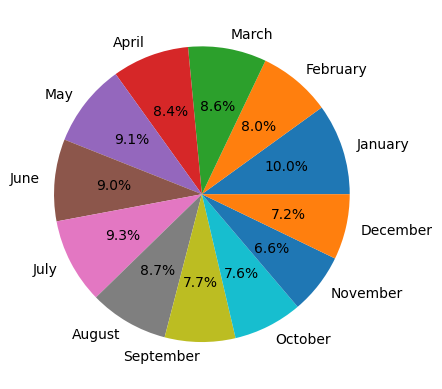

In [65]:
bins = [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12]
names = ['January', 'February', 'March', 'April', 'May', 'June', 'July', 'August', 'September', 'October', 'November', 'December']

reviews_df_filtered['month'] = pd.cut(reviews_df_filtered['timestamp.month'], bins, labels=names, ordered=False)
reviews_df_filtered.groupby('month').size().plot.pie(autopct='%1.1f%%');

In [66]:
ratings_month_df = reviews_df_filtered.groupby(['month']).size()
ratings_month_df[ratings_month_df > 0].head(12)

month
January      21315
February     17008
March        18320
April        17993
May          19396
June         19167
July         19980
August       18498
September    16504
October      16149
November     14159
December     15304
dtype: int64

We'll do the differentiation by Genres

In [67]:
import ast

def extract_genre_names(genres_dict):
    try:
        genres = ast.literal_eval(genres_dict)
        if genres:
            max_genre = max(genres, key=genres.get)
            return max_genre
        else:
            return ''
    except (SyntaxError, ValueError):
        return ''

books_df['genres_names'] = books_df['genres'].apply(extract_genre_names)

In [68]:
month_dict = {}
for month in names:
    month_dict[month] = reviews_df_filtered[reviews_df_filtered['month'] == month]

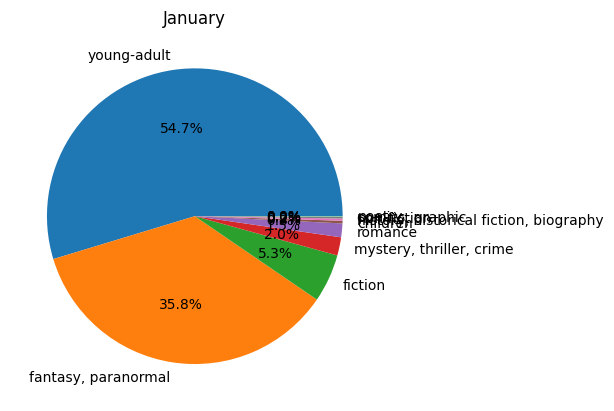

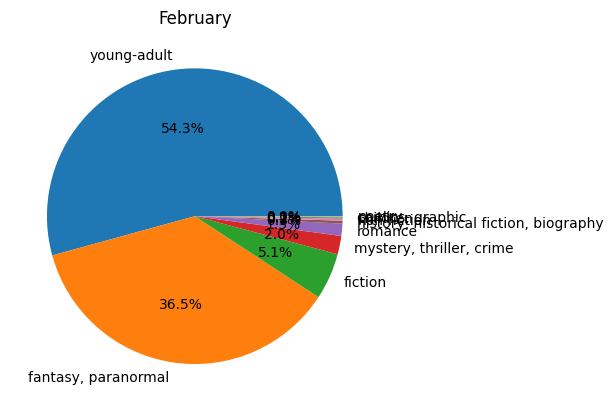

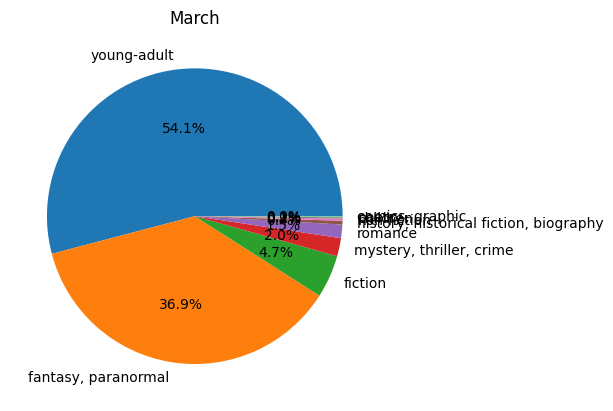

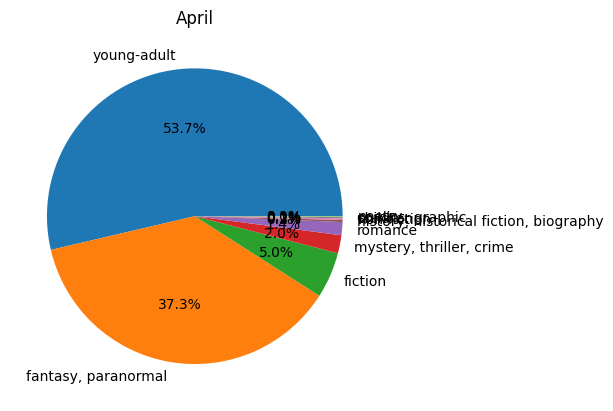

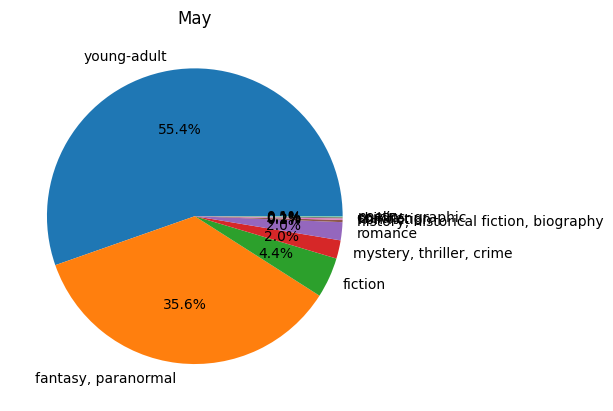

...

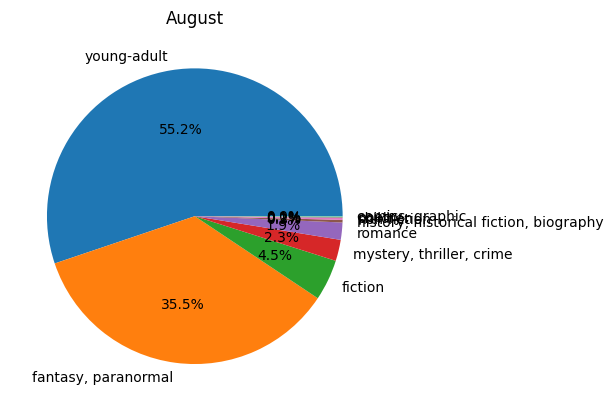

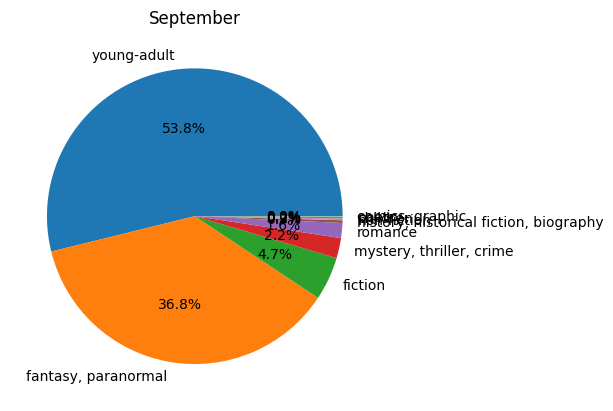

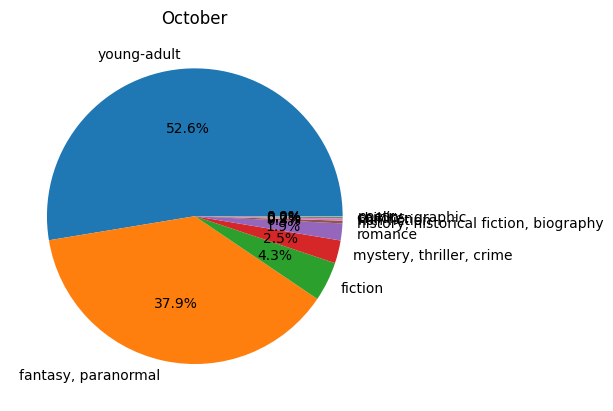

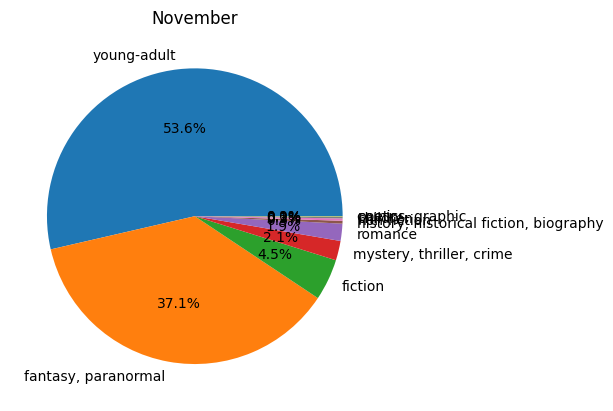

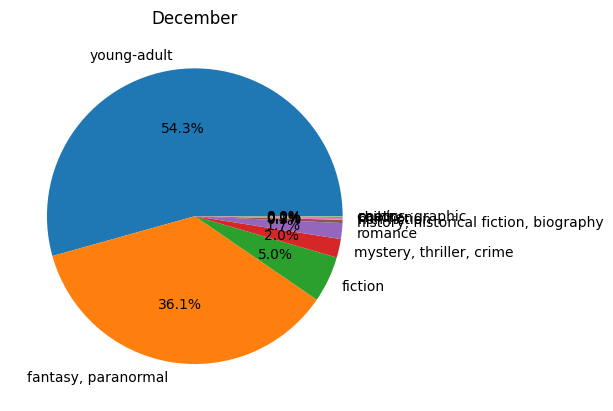

In [69]:
for month, month_df in month_dict.items():
    context_genres_df = pd.merge(month_df, books_df, left_on='book_id', right_on='book_id', how='left')
    context_ratio_df = context_genres_df.groupby('genres_names').size().sort_values(ascending=False)
    context_ratio_df.head(10).plot.pie(autopct='%1.1f%%')
    plt.title(month)
    plt.show()

Given that the difference in month, is almost insignificant, and it will consume more computational power than by season, we will try first the difference in NDCG per season, and then if there is some increase, we will try it by month!

### Seasonally

/var/folders/k3/yvsb49212nx0rzv6l20v1gy00000gn/T/ipykernel_45357/968813641.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  reviews_df_filtered['season'] = pd.cut(reviews_df_filtered['timestamp.month'], bins, labels=names, ordered=False)


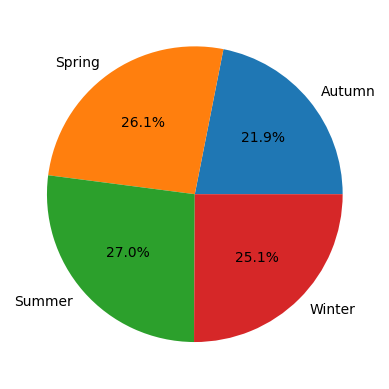

In [70]:
bins = [0, 2, 5, 8, 11, 12]
names = ['Winter', 'Spring', 'Summer', 'Autumn', 'Winter']

reviews_df_filtered['season'] = pd.cut(reviews_df_filtered['timestamp.month'], bins, labels=names, ordered=False)
reviews_df_filtered.groupby('season').size().plot.pie(autopct='%1.1f%%');

In [71]:
ratings_season_df = reviews_df_filtered.groupby(['month', 'season']).size()
ratings_season_df[ratings_season_df > 0].head(12)

month      season
January    Winter    21315
February   Winter    17008
March      Spring    18320
April      Spring    17993
May        Spring    19396
June       Summer    19167
July       Summer    19980
August     Summer    18498
September  Autumn    16504
October    Autumn    16149
November   Autumn    14159
December   Winter    15304
dtype: int64

In [72]:
ratings_winter_df = reviews_df_filtered[reviews_df_filtered['season'] == 'Winter']
ratings_spring_df = reviews_df_filtered[reviews_df_filtered['season'] == 'Spring']
ratings_summer_df = reviews_df_filtered[reviews_df_filtered['season'] == 'Summer']
ratings_autumn_df = reviews_df_filtered[reviews_df_filtered['season'] == 'Autumn']

context_df_dict = {'Winter': ratings_winter_df, 'Spring': ratings_spring_df,
                   'Summer': ratings_summer_df, 'Autumn': ratings_autumn_df}

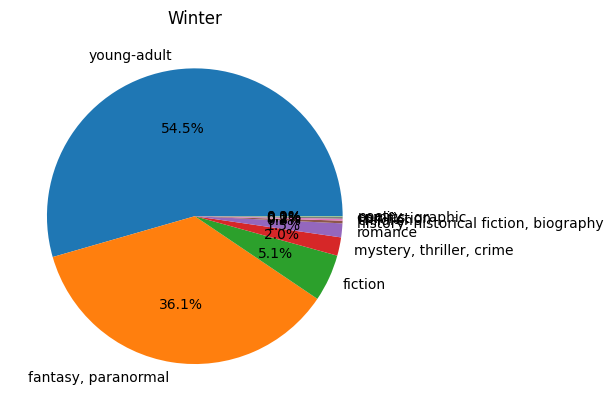

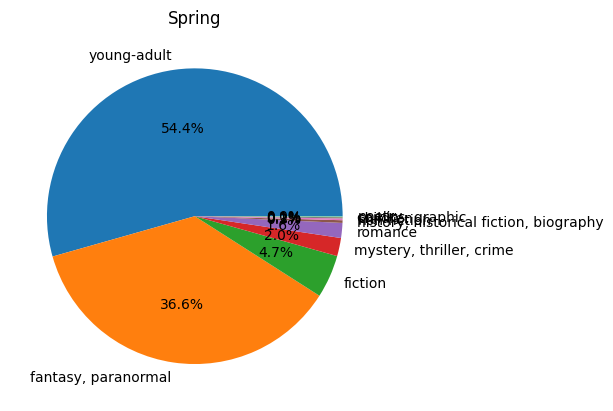

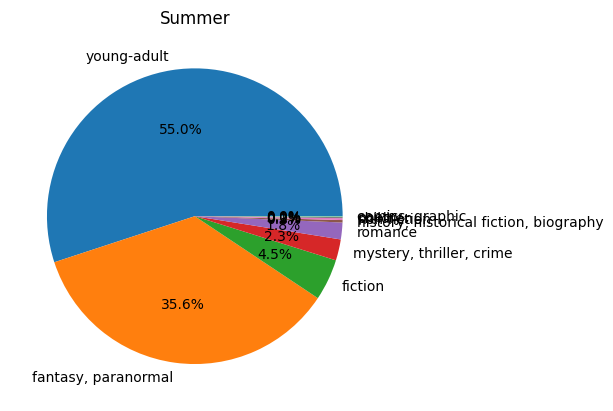

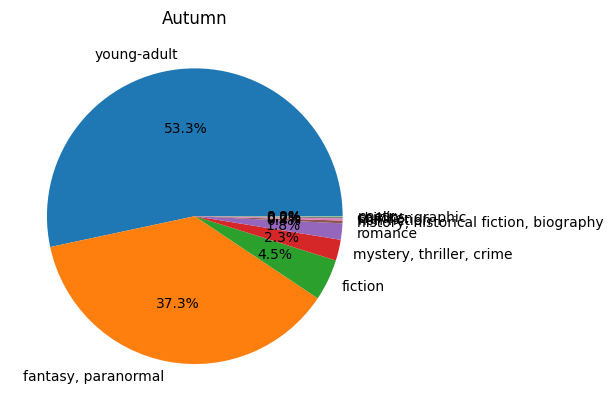

In [73]:
for context, context_df in context_df_dict.items():
  context_genres_df = pd.merge(context_df, books_df, left_on='book_id', right_on='book_id', how='left')
  context_ratio_df = context_genres_df.groupby('genres_names').size().sort_values(ascending=False)
  context_ratio_df.head(10).plot.pie(autopct='%1.1f%%')
  plt.title(context)
  plt.show()

In [74]:
def basic_stats(ratings_df, user_col, item_col):
  n_ratings = ratings_df.shape[0]
  n_users = ratings_df[user_col].nunique()
  n_items = ratings_df[item_col].nunique()
  print(f'There are {n_ratings} ratings from {n_users} users to {n_items} items')
  return n_ratings, n_users, n_items

In [75]:
basic_stats(reviews_df_filtered, 'user_id', 'book_id');

There are 213793 ratings from 4151 users to 20392 items


In [76]:
reviews_df_filtered.groupby('user_id').size().min()

1

In [77]:
reviews_df_filtered.groupby('book_id').size().min()

1

In [78]:
threshold = 20

items_num_df = reviews_df_filtered.groupby('book_id').size().rename('num_items')
items_num_gt_th_df = items_num_df[items_num_df > threshold]

reviews_df_filtered = reviews_df_filtered.join(items_num_gt_th_df, on='book_id', how='inner')
basic_stats(reviews_df_filtered, 'user_id', 'book_id');

There are 148282 ratings from 4140 users to 1857 items


In [79]:
threshold = 20

users_num_df = reviews_df_filtered.groupby('user_id').size().rename('num_users')
users_num_gt_th_df = users_num_df[users_num_df > threshold]

reviews_df_filtered = reviews_df_filtered.join(users_num_gt_th_df, on='user_id', how='inner')
basic_stats(reviews_df_filtered, 'user_id', 'book_id');

There are 128135 ratings from 2639 users to 1857 items


### Algorithm

In [71]:
n_factors = 1
n_epochs = 20
lr_all = 0.005
reg_all = 0.02


algo = SVD(n_factors=n_factors, n_epochs=n_epochs, lr_all=lr_all, reg_all=reg_all)

reader = Reader(rating_scale=(0.5, 5))

In [80]:
%%time
users_with_more_than_20_ratings = reviews_df_filtered['user_id'].value_counts()[reviews_df_filtered['user_id'].value_counts() > 20].index
reviews_df_filtered = reviews_df_filtered[reviews_df_filtered['user_id'].isin(users_with_more_than_20_ratings)]
data = Dataset.load_from_df(reviews_df_filtered[['user_id', 'book_id', 'rating']], reader)

trainset, testset = train_test_split(data, test_size=.20, random_state=my_seed)

algo.fit(trainset);
predictions = algo.test(testset)
predictions_df = pd.DataFrame(predictions)

CPU times: user 289 ms, sys: 4.24 ms, total: 293 ms
Wall time: 294 ms


In [81]:
predictions_df.head()

,uid,iid,r_ui,est,details
0,729b6d87154f1b13798bd5942f2cbdb5,23305614,4.0,3.976016,{'was_impossible': False}
1,ef46db3378eadd7045f8d0e71c5adc7a,10507293,4.0,3.982582,{'was_impossible': False}
2,606c583d10642cbfc6b12970a3c30ecc,26156987,4.0,3.882111,{'was_impossible': False}
3,6975d0644db9d1311acce4e489d5bd84,6931356,2.0,3.064643,{'was_impossible': False}
4,0f88d5ddd44e983112957b2077bac461,23395680,5.0,4.662121,{'was_impossible': False}


In [82]:
predictions_byuser_df = predictions_df.groupby('uid')[['iid', 'r_ui', 'est']].agg(lambda x: list(x))

predictions_byuser_df.head(2)

,iid,r_ui,est
uid,,,
00254cd48d3d8a99ca9f0ed44fa69d5f,"[9917938, 7198988]","[5.0, 5.0]","[4.675342411045005, 3.62289049885311]"
002a023d3de233b4bd3ec4fc3e9c581a,"[2741766, 10594356, 8901953, 23168406, 1728681...","[4.0, 3.0, 4.0, 3.0, 3.0, 5.0, 4.0, 5.0, 4.0, ...","[4.197227294373938, 3.7692447937416995, 4.0398..."


In [83]:
import sklearn.metrics as metrics

In [84]:
def ndcg_multiple_users(relevant_items_all_users, predictions_ranking_all_users, k=5):
    ndcg_list = []
    # Loop all users
    for i in range(len(relevant_items_all_users)):
      # Skip users with only 1 item in the test data, as no NDCG can be computed
      if len(relevant_items_all_users[i]) > 1:
        ndcg = metrics.ndcg_score([relevant_items_all_users[i]],
                                  [predictions_ranking_all_users[i]], k=k)
        ndcg_list.append(ndcg)

    return np.mean(ndcg_list)

In [85]:
ndcg_multiple_users(predictions_byuser_df['r_ui'].tolist(),
                    predictions_byuser_df['est'].tolist())

0.9244764822253424

In [86]:
context_df_dict

{'Winter':                                  user_id   book_id  \
 7       012515e5802b2e0f42915118c90fa04b  13623150   
 8       012515e5802b2e0f42915118c90fa04b  13104080   
 9       012515e5802b2e0f42915118c90fa04b  13508069   
 10      012515e5802b2e0f42915118c90fa04b   8803932   
 11      012515e5802b2e0f42915118c90fa04b  11454587   
 ...                                  ...       ...   
 243873  cbd3d94eeb777cbdb64b766afe3e5636  17697452   
 243874  cbd3d94eeb777cbdb64b766afe3e5636  12568505   
 243875  cbd3d94eeb777cbdb64b766afe3e5636  13206828   
 243878  cbd3d94eeb777cbdb64b766afe3e5636  20917191   
 243883  cbd3d94eeb777cbdb64b766afe3e5636  15801169   
 
                                review_id  rating  \
 7       70ebc0d4940def9bbaa54c029bb2b8a0       5   
 8       528000001d6705f260ac8c7a58327018       5   
 9       5b12c5a78b6c7d41c601555bbf8a088f       5   
 10      21c41d209d0e13c55a73c5208f11f952       5   
 11      b3881c3c1c9e0993e5d4f14971d914ac       5   
 ...      

In [87]:
%%time
for context, ratings_subset_df in context_df_dict.items():
  data = Dataset.load_from_df(ratings_subset_df[['user_id', 'book_id', 'rating']], reader)
  trainset, testset = train_test_split(data, test_size=.20, random_state=my_seed)
  algo.fit(trainset);
  predictions = algo.test(testset)
  predictions_df = pd.DataFrame(predictions)
  predictions_byuser_df = predictions_df.groupby('uid')[['iid', 'r_ui', 'est']].agg(lambda x: list(x))
  ndcg = ndcg_multiple_users(predictions_byuser_df['r_ui'].tolist(),
                             predictions_byuser_df['est'].tolist())
  print(f'{context}: {ndcg}')

Winter: 0.950862131749266
Spring: 0.9540074141190461
Summer: 0.9501499840729783
Autumn: 0.9548239043721295
CPU times: user 1.79 s, sys: 8.88 ms, total: 1.8 s
Wall time: 1.8 s


As it can be seen, doing it by seasonality it does improve the accuracy regarding NDCG. 

Let's now try it just in case per month!

In [88]:
%%time
for context, ratings_subset_df in month_dict.items():
  data = Dataset.load_from_df(ratings_subset_df[['user_id', 'book_id', 'rating']], reader)
  trainset, testset = train_test_split(data, test_size=.20, random_state=my_seed)
  algo.fit(trainset);
  predictions = algo.test(testset)
  predictions_df = pd.DataFrame(predictions)
  predictions_byuser_df = predictions_df.groupby('uid')[['iid', 'r_ui', 'est']].agg(lambda x: list(x))
  ndcg = ndcg_multiple_users(predictions_byuser_df['r_ui'].tolist(),
                             predictions_byuser_df['est'].tolist())
  print(f'{context}: {ndcg}')

January: 0.9613059216155367
February: 0.9583316595138623
March: 0.9650193702653869
April: 0.9624014844297059
May: 0.9601382475338235
June: 0.9589739628894082
July: 0.9579086282169593
August: 0.955692270665672
September: 0.9620538560540207
October: 0.9622675473352222
November: 0.9603375852645644
December: 0.9601267135928
CPU times: user 2.02 s, sys: 9.49 ms, total: 2.02 s
Wall time: 2.03 s


Clearly the context recommender by month is the best model up to now, with regards to NDCG!

## FINAL MODEL

In [260]:
import random

random.seed(my_seed)
np.random.seed(my_seed)

### CF + CONTEXT MODEL

In [262]:
# Convert 'read_at' timestamp to datetime
reviews_df['timestamp'] = pd.to_datetime(reviews_df['read_at'], format='%a %b %d %H:%M:%S %z %Y', errors='coerce')
reviews_df['timestamp'] = pd.to_datetime(reviews_df['timestamp'], utc=True, errors='coerce')

# Count the number of rows with invalid timestamps
deleted_rows = len(reviews_df) - len(reviews_df.dropna(subset=['timestamp']))

# Remove rows with invalid timestamps
reviews_df = reviews_df.dropna(subset=['timestamp'])

print("Number of rows deleted:", deleted_rows)

reviews_df['timestamp.month'] = reviews_df['timestamp'].dt.month

Number of rows deleted: 0


In [263]:
bins = [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12]
names = ['January', 'February', 'March', 'April', 'May', 'June', 'July', 'August', 'September', 'October', 'November', 'December']

reviews_df['month'] = pd.cut(reviews_df['timestamp.month'], bins, labels=names, ordered=False)

In [265]:
file_path = "/Users/pablochamorro/Desktop/Coding/Recommendation Engines/project/reviews_df_filtered.csv"
reviews_df.to_csv(file_path, index=False)

We can now fit the model with the whole dataset!

In [49]:
reader = Reader(rating_scale=(0, 5))
data = Dataset.load_from_df(reviews_df[['user_id', 'book_id', 'rating']], reader)

trainset, testset = train_test_split(data, test_size=.001, random_state=my_seed)

In [50]:
n_factors = 1
n_epochs = 20
lr_all = 0.005
reg_all = 0.02

collaborative_f_model = SVD(n_factors=n_factors, n_epochs=n_epochs, lr_all=lr_all, reg_all=reg_all)
collaborative_f_model.fit(trainset)

In [51]:
directory = "/Users/pablochamorro/Desktop/Coding/Recommendation Engines/project"
# Save the model using pickle
file_path = os.path.join(directory, "collaborative_filtering_model.pkl")
with open(file_path, "wb") as f:
    pickle.dump(collaborative_f_model, f)


In [266]:
all_df_filtered = reviews_df.merge(books_df, on='book_id')
all_df_filtered.set_index("book_id", inplace=True)

In [307]:
file_path = "/Users/pablochamorro/Desktop/Coding/Recommendation Engines/project/collaborative_filtering_model.pkl"
with open(file_path, 'rb') as file:
    collaborative_f_model = pickle.load(file)

In [15]:
def get_user_recommendations_CF_context(uid, df, n=10):

    user_books = df[df['user_id'] == uid].index
    user_book_ids = df[df.index.isin(user_books)].index.unique()
    unique_books = set()

    for book_id in user_book_ids:
        book_title = df.loc[int(book_id), 'title'].iloc[0]  # Access the first element of the Series
        unique_books.add((book_id, book_title))

    print(f"Books for user: {uid} with user_id: {uid}")
    for book_id, book_title in unique_books:
        print(f"Book ID: {book_id}. Book title: {book_title}")

    chosen_book_id = int(input("Enter the book_id of the book you want recommendations for: ").strip())
    month = df.loc[(df['user_id'] == uid) & (df.index == chosen_book_id), "month"].iloc[0]
    user_items = df[(df['user_id'] == uid) & (df['month'] == month)].index.unique()  
    all_items = df[df['month'] == month].index.unique()
    items_to_recommend = np.setdiff1d(all_items, user_items)
    
    predictions = []
    for iid in items_to_recommend:
        pred = collaborative_f_model.predict(uid, iid, verbose=False)
        predictions.append({'book_id': iid, 'prediction': pred.est})

    predictions.sort(key=lambda x: x['prediction'], reverse=True)
    top_n_recommendations = predictions[:n]
    top_n_titles = [df[(df.index == pred['book_id']) & (df['month'] == month)]['title'].iloc[0] for pred in top_n_recommendations]
    top_n_author = [df[(df.index == pred['book_id']) & (df['month'] == month)]['authors'].iloc[0] for pred in top_n_recommendations]
    author_names = []
    for authors_str in top_n_author:
        authors_list = ast.literal_eval(authors_str)
        names = [author['name'] for author in authors_list]
        author_names.append(names[0])
    top_n_publisher = [df[(df.index == pred['book_id']) & (df['month'] == month)]['publisher'].iloc[0] for pred in top_n_recommendations]

    data = {'title': top_n_titles,
            'author': author_names,
            'publisher': top_n_publisher,
            'prediction': [pred['prediction'] for pred in top_n_recommendations]}
    df_recommendations = pd.DataFrame(data)

    return df_recommendations

In [16]:
user_id = '91efd74c298b00a55ef9bcf345ec9cc3'
n = 10
df_recommendations = get_user_recommendations_CF_context(user_id, all_df_filtered, n)
df_recommendations

Books for user: 91efd74c298b00a55ef9bcf345ec9cc3 with user_id: 91efd74c298b00a55ef9bcf345ec9cc3
Book ID: 18667779. Book title: Everything Leads to You
Book ID: 18692431. Book title: Everything, Everything
Book ID: 23310751. Book title: First & Then
Book ID: 27830287. Book title: It Started With Goodbye
Book ID: 6936382. Book title: Anna and the French Kiss (Anna and the French Kiss, #1)
Book ID: 13477676. Book title: Forgive Me, Leonard Peacock
Book ID: 22429350. Book title: The Start of Me and You
Book ID: 22910900. Book title: The Rest of Us Just Live Here
Book ID: 31423684. Book title: Zenn Diagram
Book ID: 28814848. Book title: The Light Fantastic
Book ID: 23288804. Book title: No Love Allowed (Dodge Cove, #1)
Book ID: 23305614. Book title: Finding Audrey
Book ID: 25613472. Book title: A List of Cages
Book ID: 32827188. Book title: Sasquatch, Love, and Other Imaginary Things
Book ID: 30074913. Book title: Buzz Books 2016: Young Adult Fall/Winter
Book ID: 6482837. Book title: Before

KeyError: 'month'

### CONTENT MODEL

In [288]:
from sentence_transformers import SentenceTransformer
from sklearn.metrics.pairwise import pairwise_distances
from sklearn.feature_extraction.text import CountVectorizer

In [289]:
all_df_filtered = reviews_df.merge(books_df, on='book_id')
all_df_filtered.set_index("book_id", inplace=True)

In [291]:
top_books_ids = all_df_filtered.index.unique()
filtered_books_df = books_df[books_df['book_id'].isin(top_books_ids)]
filtered_books_df.reset_index(drop=True, inplace=True)
filtered_books_df.shape[0]

15692

In [292]:
model = SentenceTransformer('distilbert-base-nli-mean-tokens')
embeddings = model.encode(filtered_books_df['description'], show_progress_bar=True)

Batches:   0%|          | 0/491 [00:00<?, ?it/s]

In [293]:
filtered_books_df['title'] = filtered_books_df['title'].str.strip().str.lower()
filtered_books_df.set_index('book_id', inplace=True)

/var/folders/k3/yvsb49212nx0rzv6l20v1gy00000gn/T/ipykernel_58687/3527680803.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  filtered_books_df['title'] = filtered_books_df['title'].str.strip().str.lower()


In [294]:
embeddings_df = pd.DataFrame(embeddings)
embeddings_df.index = filtered_books_df.index
embeddings_df.head()

,0,1,2,3,4,5,6,7,8,9,...,758,759,760,761,762,763,764,765,766,767
book_id,,,,,,,,,,,,,,,,,,,,,
21401181,-0.634513,-0.803615,0.287022,-0.598381,-0.379536,-0.505996,0.087189,-0.623852,0.804649,0.856308,...,-0.277189,0.760712,0.033615,0.691138,-0.037560,-0.414531,-0.213930,-0.771974,0.150110,-0.696176
22642971,-0.261218,-0.283399,0.231602,-0.665426,-0.172117,-0.388628,0.151258,-0.455277,0.540079,0.535548,...,-0.545867,-0.476644,0.052030,0.515152,0.360673,-0.460168,0.109375,-0.153618,-0.270658,-0.639353
25414982,-0.347720,-0.441079,0.265948,-0.785311,-0.352077,-0.184086,-0.602574,-0.711446,0.496077,0.925610,...,-0.572019,-0.486802,0.118740,-0.102510,0.272351,-0.390310,-0.196216,-0.304366,-0.147151,-0.260448
17262776,-0.403006,-0.522975,0.091839,-1.345276,-0.191902,-0.576161,-0.214481,-0.842578,0.716379,0.708994,...,-0.391358,-0.324737,0.822214,0.186650,0.367700,-1.144347,-0.246330,-0.078500,0.228080,-0.067004
11890856,-0.361624,-0.279369,0.567769,-0.950251,0.009834,-0.495813,-0.350512,-0.507734,0.729923,0.061190,...,0.296826,-1.011845,1.694005,-0.021907,0.456202,-0.939145,-0.157358,-0.674151,-0.136287,-0.998420


In [295]:
def compute_similarities(vectorization_df):
  sim = pairwise_distances(vectorization_df, vectorization_df, metric='cosine')
  sim_df = pd.DataFrame(sim, columns=filtered_books_df.index)
  sim_df.index = filtered_books_df.index
  return sim_df

In [296]:
bert_sim_df = compute_similarities(embeddings_df)

In [297]:
bert_sim_df.head(2)

book_id,21401181,22642971,25414982,17262776,11890856,13519484,12597209,10806009,10806004,30971685,...,26534112,12244583,6986841,24397043,17339959,279668,279665,279666,26534110,23636536
book_id,,,,,,,,,,,,,,,,,,,,,
21401181,0.000000,2.815421e-01,0.288652,0.283788,0.371462,0.142547,0.338211,0.243918,0.236321,0.299950,...,0.741164,0.214875,0.273665,0.270397,0.236811,0.294516,0.368041,0.294023,0.218529,0.507050
22642971,0.281542,5.960464e-08,0.265085,0.197261,0.261957,0.239356,0.295032,0.191274,0.200523,0.204537,...,0.704086,0.202540,0.259428,0.264645,0.305168,0.293029,0.386154,0.304225,0.299561,0.315521


In [15]:
def top_n(sim_df, df, df_all, item, uid, n):

    user_items = df_all[df_all['user_id'] == uid].index.unique()  
    all_items = df_all.index.unique()
    items_to_recommend = np.setdiff1d(all_items, user_items)
    recommendations_df = df[['description']].copy()
    recommendations_df['distance'] = sim_df.loc[item]
    chosen_book_name = df_all.loc[int(item), 'title']
    recommendations_df = recommendations_df.loc[items_to_recommend]
    recommendations_df = recommendations_df.join(df_all[['title']])
    recommendations_df = recommendations_df.loc[items_to_recommend]
    seen_titles = set()
    unique_recommendations = []

    for index, row in recommendations_df.iterrows():
        title = row['title']
        if title not in seen_titles:
            unique_recommendations.append(row)
            seen_titles.add(title)

    unique_recommendations = pd.DataFrame(unique_recommendations)
    # Create a series with the same length as unique_recommendations['title'] containing chosen_book_name
    chosen_book_series = pd.Series([chosen_book_name] * len(unique_recommendations), index=unique_recommendations.index)
    unique_recommendations = unique_recommendations[~((unique_recommendations['title'].equals(chosen_book_series)) & (unique_recommendations.index != int(item)))]
    unique_recommendations.drop(index=int(item), inplace=True, errors='ignore') # We drop it again, just in case! 
    unique_recommendations = unique_recommendations.sort_values('distance').head(n)



    return unique_recommendations

In [16]:
def get_user_recommendations_bert(uid, df, filtered_books_df, bert_sim_df, n=10):
    user_books = df[df['user_id'] == uid].index
    user_book_ids = df[df.index.isin(user_books)].index.unique()
    unique_books = set()

    for book_id in user_book_ids:
        book_title = df.loc[int(book_id), 'title'].iloc[0]  # Access the first element of the Series
        unique_books.add((book_id, book_title))

    print(f"Books for user: {uid} with user_id: {uid}")
    for book_id, book_title in unique_books:
        print(f"Book ID: {book_id}. Book title: {book_title}")

    chosen_book_id = int(input("Enter the book_id of the book you want recommendations for: ").strip())

    # Get top n recommendations    
    chosen_book_name = df.loc[int(chosen_book_id), 'title']
    recommendations = top_n(bert_sim_df, filtered_books_df, df, chosen_book_id, uid, n+1)
    authors = df.loc[recommendations.index, 'authors']
    publishers = df.loc[recommendations.index, 'publisher']
    authors = authors.drop_duplicates()
    recommendations["authors"] = authors
    publishers = publishers.drop_duplicates()
    recommendations["publishers"] = publishers
    recommendations['authors'].fillna('[]', inplace=True)
    recommendations['authors'] = recommendations['authors'].apply(ast.literal_eval)
    recommendations['author_name'] = recommendations['authors'].apply(lambda x: x[0]['name'] if x else None)
    recommendations = recommendations[['title', 'author_name', 'publishers', 'description', 'distance']]
    
    return chosen_book_name, recommendations


In [17]:
user_id = '91efd74c298b00a55ef9bcf345ec9cc3'
n = 10
book_name, recommendations = get_user_recommendations_bert(user_id, all_df_filtered, filtered_books_df, bert_sim_df, n)
recommendations

Books for user: 91efd74c298b00a55ef9bcf345ec9cc3 with user_id: 91efd74c298b00a55ef9bcf345ec9cc3
Book ID: 21018154. Book title: Bookishly Ever After (Ever After, #1)
Book ID: 18460392. Book title: All the Bright Places
Book ID: 6936382. Book title: Anna and the French Kiss (Anna and the French Kiss, #1)
Book ID: 20309175. Book title: My True Love Gave to Me: Twelve Holiday Stories
Book ID: 22429350. Book title: The Start of Me and You
Book ID: 19542841. Book title: More Happy Than Not
Book ID: 23341252. Book title: This Is Our Story
Book ID: 25063781. Book title: Summer Days and Summer Nights: Twelve Love Stories
Book ID: 13477676. Book title: Forgive Me, Leonard Peacock
Book ID: 25893582. Book title: Tell Me Three Things
Book ID: 25613472. Book title: A List of Cages
Book ID: 22910900. Book title: The Rest of Us Just Live Here
Book ID: 25528801. Book title: Exit, Pursued by a Bear
Book ID: 28814848. Book title: The Light Fantastic
Book ID: 23305614. Book title: Finding Audrey
Book ID: 

,title,author_name,publishers,description,distance
30362265,"Order in the Court (The Survivor's Club, #2)",Casey Lawrence,Harmony Ink,After witnessing the murders of her three best...,0.072283
24847594,Snow Globe,Jeanne Skartsiaris,CreateSpace,Troubled teen. Juvenile delinquent. Aja Harmon...,0.078155
397468,"The Wildflowers (Wildflowers, #1-4)",V.C. Andrews,Atria Books,Four Girls With Dark Secrets To Share.\nFour E...,0.079423
18584569,Of Scars and Stardust,Andrea Hannah,Flux,"After her little sister mysteriously vanishes,...",0.080088
14287205,Chocolate-Covered Baloney (Confessions of Apri...,K.D. McCrite,Thomas Nelson,The last thing April Grace wants is more chang...,0.080331
17286914,Also Known As,Robin Benway,Walker Childrens,Being a 16-year-old safecracker and active-dut...,0.082093
23158400,Into a Million Pieces,Angela V. Cook,"Red Adept Publishing, LLC",Allison McKready is a succubus. So is her twin...,0.082263
23014725,Delicate Monsters,Stephanie Kuehn,St. Martin's Griffin,From the Morris-Award winning author of Charm ...,0.084213
22244627,Pictures of You,Juliette Caron,Createspace,"In a moment, September Jones's life is changed...",0.085002
5043829,The Sweet In-Between,Sheri Reynolds,Center Point,"With her father in prison, her mother dead, an...",0.085249


### Random 

In [380]:
import numpy as np
from surprise.prediction_algorithms.algo_base import AlgoBase

class MyRandomAlgorithm(AlgoBase):

    def __init__(self):
        AlgoBase.__init__(self)

    def estimate(self, u, i):
        # Note u and i are not used, this RS does not personalize based on neither the user nor the item
        return np.random.normal(loc=self.train_mean, scale=self.train_std)

    def fit(self, trainset):
        AlgoBase.fit(self, trainset)

        ratings = [r for (_, _, r) in self.trainset.all_ratings()]
        self.train_mean = np.mean(ratings)
        self.train_std = np.std(ratings)

        return self


3.9904550004207846


In [382]:
random_RS.fit(trainset)
directory = "/Users/pablochamorro/Desktop/Coding/Recommendation Engines/project"
file_path = os.path.join(directory, "random_model.pkl")
with open(file_path, "wb") as f:
    pickle.dump(random_RS, f)

In [383]:
file_path = "/Users/pablochamorro/Desktop/Coding/Recommendation Engines/project/random_model.pkl"
with open(file_path, 'rb') as file:
    random_model = pickle.load(file)

In [395]:
def get_user_recommendations_Random(recommender, uid, df, n=10):

    user_books = df[df['user_id'] == uid].index
    user_book_ids = df[df.index.isin(user_books)].index.unique()
    unique_books = set()

    for book_id in user_book_ids:
        book_title = df.loc[int(book_id), 'title'].iloc[0]  
        unique_books.add((book_id, book_title))

    print(f"Books for user: {uid} with user_id: {uid}")
    for book_id, book_title in unique_books:
        print(f"Book ID: {book_id}. Book title: {book_title}")

    chosen_book_id = int(input("Enter the book_id of the book you want recommendations for: ").strip())
    user_items = df[(df['user_id'] == uid)].index.unique()  
    all_items = df.index.unique()
    items_to_recommend = np.setdiff1d(all_items, user_items)
    
    predictions = []
    for iid in items_to_recommend:
        pred = recommender.estimate(uid, iid)
        predictions.append({'book_id': iid, 'prediction': pred})

    predictions.sort(key=lambda x: x['prediction'], reverse=True)
    top_n_recommendations = predictions[:n]
    top_n_titles = [df[(df.index == pred['book_id'])]['title'].iloc[0] for pred in top_n_recommendations]
    top_n_author = [df[(df.index == pred['book_id'])]['authors'].iloc[0] for pred in top_n_recommendations]
    author_names = []
    for authors_str in top_n_author:
        authors_list = ast.literal_eval(authors_str)
        names = [author['name'] for author in authors_list]
        author_names.append(names[0])
    top_n_publisher = [df[(df.index == pred['book_id'])]['publisher'].iloc[0] for pred in top_n_recommendations]

    data = {'title': top_n_titles,
            'author': author_names,
            'publisher': top_n_publisher} # No prediction, as they are random, and the values are above 5, which shouldn't be
    df_recommendations = pd.DataFrame(data)

    return df_recommendations

In [397]:
user_id = '91efd74c298b00a55ef9bcf345ec9cc3'
n = 10
df_recommendations = get_user_recommendations_Random(random_model, user_id, all_df_filtered, n)
df_recommendations

Books for user: 91efd74c298b00a55ef9bcf345ec9cc3 with user_id: 91efd74c298b00a55ef9bcf345ec9cc3
Book ID: 6482837. Book title: Before I Fall
Book ID: 1629601. Book title: The Disreputable History of Frankie Landau-Banks
Book ID: 25893582. Book title: Tell Me Three Things
Book ID: 23288804. Book title: No Love Allowed (Dodge Cove, #1)
Book ID: 18460392. Book title: All the Bright Places
Book ID: 18667779. Book title: Everything Leads to You
Book ID: 25063781. Book title: Summer Days and Summer Nights: Twelve Love Stories
Book ID: 6936382. Book title: Anna and the French Kiss (Anna and the French Kiss, #1)
Book ID: 13477676. Book title: Forgive Me, Leonard Peacock
Book ID: 22910900. Book title: The Rest of Us Just Live Here
Book ID: 22429350. Book title: The Start of Me and You
Book ID: 25486998. Book title: P.S. I Like You


,title,author,publisher,prediction
0,A Bridge to the Stars,Henning Mankell,Delacorte Books for Young Readers,7.859339
1,"Jealousy (Strange Angels, #3)",Lili St. Crow,Razorbill,7.784558
2,"Wings (Wings, #1)",Aprilynne Pike,HarperTeen,7.692809
3,Requiem,Lauren Oliver,HarperCollins,7.612013
4,Red Velvet Crush,Christina Meredith,Greenwillow Books,7.542453
5,Disconnected,Lisa M. Cronkhite,Poisoned Pencil,7.501829
6,A Long Way from You,Gwendolyn Heasley,HarperTeen,7.489739
7,"The Trap (The Hunt, #3)",Andrew Fukuda,St. Martin's Griffin,7.469620
8,"Incarnate (Newsoul, #1)",Jodi Meadows,Katherine Tegen,7.464845
9,American Ace,Marilyn Nelson,Dial Books,7.452324


Now for the probability Exploration vs Exploitation

In [400]:
def get_user_recommendations_Random_probability(recommender, uid, df, n=10):

    user_books = df[df['user_id'] == uid].index
    user_book_ids = df[df.index.isin(user_books)].index.unique()
    unique_books = set()

    for book_id in user_book_ids:
        book_title = df.loc[int(book_id), 'title'].iloc[0]  
        unique_books.add((book_id, book_title))

    print(f"Books for user: {uid} with user_id: {uid}")
    for book_id, book_title in unique_books:
        print(f"Book ID: {book_id}. Book title: {book_title}")

    chosen_book_id = int(input("Enter the book_id of the book you want recommendations for: ").strip())
    user_items = df[(df['user_id'] == uid)].index.unique()  
    all_items = df.index.unique()
    items_to_recommend = np.setdiff1d(all_items, user_items)
    
    predictions = []
    for iid in items_to_recommend:
        pred = recommender.estimate(uid, iid)
        predictions.append({'book_id': iid, 'prediction': pred})

    predictions.sort(key=lambda x: x['prediction'], reverse=True)
    top_n_recommendations = predictions[:n]
    top_n_titles = [df[(df.index == pred['book_id'])]['title'].iloc[0] for pred in top_n_recommendations]
    top_n_author = [df[(df.index == pred['book_id'])]['authors'].iloc[0] for pred in top_n_recommendations]
    author_names = []
    for authors_str in top_n_author:
        authors_list = ast.literal_eval(authors_str)
        names = [author['name'] for author in authors_list]
        author_names.append(names[0])
    top_n_publisher = [df[(df.index == pred['book_id'])]['publisher'].iloc[0] for pred in top_n_recommendations]

    data = {'title': top_n_titles,
            'author': author_names,
            'publisher': top_n_publisher} # No prediction, as they are random, and the values are above 5, which shouldn't be
    df_recommendations = pd.DataFrame(data)

    return df_recommendations

### FINAL PIPELINE

In [1]:
# LIBRARIES
import pickle
import pandas as pd
import numpy as np
import ast
from sentence_transformers import SentenceTransformer
from sklearn.metrics.pairwise import pairwise_distances
import random 
from surprise.prediction_algorithms.algo_base import AlgoBase


# LOADING THE MAIN DATASETS
file_path = "/Users/pablochamorro/Desktop/Coding/Recommendation Engines/project/books_df.csv"
books_df = pd.read_csv(file_path)
file_path_1 = "/Users/pablochamorro/Desktop/Coding/Recommendation Engines/project/reviews_df.csv"
row_to_skip = 376979
reviews_df = pd.read_csv(file_path_1, skiprows=[row_to_skip])

# Convert 'read_at' timestamp to datetime
reviews_df['timestamp'] = pd.to_datetime(reviews_df['read_at'], format='%a %b %d %H:%M:%S %z %Y', errors='coerce')
reviews_df['timestamp'] = pd.to_datetime(reviews_df['timestamp'], utc=True, errors='coerce')
reviews_df = reviews_df.dropna(subset=['timestamp'])
reviews_df['timestamp.month'] = reviews_df['timestamp'].dt.month
bins = [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12]
names = ['January', 'February', 'March', 'April', 'May', 'June', 'July', 'August', 'September', 'October', 'November', 'December']
reviews_df['month'] = pd.cut(reviews_df['timestamp.month'], bins, labels=names, ordered=False)

all_df_filtered = reviews_df.merge(books_df, on='book_id')
all_df_filtered.set_index("book_id", inplace=True)

## LOADING THE MODELS

######   COLLABORATIVE + CONTEXT MODEL
file_path = "/Users/pablochamorro/Desktop/Coding/Recommendation Engines/project/collaborative_filtering_model.pkl"
with open(file_path, 'rb') as file:
    collaborative_f_model = pickle.load(file)

######   RANDOM MODEL
import numpy as np
from surprise.prediction_algorithms.algo_base import AlgoBase

class MyRandomAlgorithm(AlgoBase):

    def __init__(self):
        AlgoBase.__init__(self)

    def estimate(self, u, i):
        # Note u and i are not used, this RS does not personalize based on neither the user nor the item
        return np.random.normal(loc=self.train_mean, scale=self.train_std)

    def fit(self, trainset):
        AlgoBase.fit(self, trainset)

        ratings = [r for (_, _, r) in self.trainset.all_ratings()]
        self.train_mean = np.mean(ratings)
        self.train_std = np.std(ratings)

        return self

file_path = "/Users/pablochamorro/Desktop/Coding/Recommendation Engines/project/random_model.pkl"
with open(file_path, 'rb') as file:
    random_model = pickle.load(file)

# FUNCTION FOR COLLABORATIVE FILTERING
def get_user_recommendations_CF_context(recommender, uid, df, n=10):

    user_books = df[df['user_id'] == uid].index
    user_book_ids = df[df.index.isin(user_books)].index.unique()
    unique_books = set()

    for book_id in user_book_ids:
        book_title = df.loc[int(book_id), 'title'].iloc[0]  # Access the first element of the Series
        unique_books.add((book_id, book_title))

    print(f"Books for user: {uid} with user_id: {uid}")
    for book_id, book_title in unique_books:
        print(f"Book ID: {book_id}. Book title: {book_title}")

    chosen_book_id = int(input("Enter the book_id of the book you want recommendations for: ").strip())
    month = df.loc[(df['user_id'] == uid) & (df.index == chosen_book_id), "month"].iloc[0]
    user_items = df[(df['user_id'] == uid) & (df['month'] == month)].index.unique()  
    all_items = df[df['month'] == month].index.unique()
    items_to_recommend = np.setdiff1d(all_items, user_items)
    
    predictions = []
    for iid in items_to_recommend:
        pred = recommender.predict(uid, iid, verbose=False)
        predictions.append({'book_id': iid, 'prediction': pred.est})

    predictions.sort(key=lambda x: x['prediction'], reverse=True)
    top_n_recommendations = predictions[:n]
    top_n_titles = [df[(df.index == pred['book_id']) & (df['month'] == month)]['title'].iloc[0] for pred in top_n_recommendations]
    top_n_author = [df[(df.index == pred['book_id']) & (df['month'] == month)]['authors'].iloc[0] for pred in top_n_recommendations]
    author_names = []
    for authors_str in top_n_author:
        authors_list = ast.literal_eval(authors_str)
        names = [author['name'] for author in authors_list]
        author_names.append(names[0])
    top_n_publisher = [df[(df.index == pred['book_id']) & (df['month'] == month)]['publisher'].iloc[0] for pred in top_n_recommendations]

    data = {'title': top_n_titles,
            'author': author_names,
            'publisher': top_n_publisher,
            'prediction': [pred['prediction'] for pred in top_n_recommendations]}
    df_recommendations = pd.DataFrame(data)

    return df_recommendations


#####   CONTENT-BASED (BERT) MODEL

# Dataframes loading and preparation!

top_books_ids = all_df_filtered.index.unique()
filtered_books_df = books_df[books_df['book_id'].isin(top_books_ids)]
filtered_books_df.reset_index(drop=True, inplace=True)
filtered_books_df.shape[0]

model = SentenceTransformer('distilbert-base-nli-mean-tokens')
embeddings = model.encode(filtered_books_df['description'], show_progress_bar=True)

filtered_books_df['title'] = filtered_books_df['title'].str.strip().str.lower()
filtered_books_df.set_index('book_id', inplace=True)

embeddings_df = pd.DataFrame(embeddings)
embeddings_df.index = filtered_books_df.index

def compute_similarities(vectorization_df):
  sim = pairwise_distances(vectorization_df, vectorization_df, metric='cosine')
  sim_df = pd.DataFrame(sim, columns=filtered_books_df.index)
  sim_df.index = filtered_books_df.index
  return sim_df

bert_sim_df = compute_similarities(embeddings_df)

# TOP N FUNCTION
def top_n(sim_df, df, df_all, item, uid, n):

    user_items = df_all[df_all['user_id'] == uid].index.unique()  
    all_items = df_all.index.unique()
    items_to_recommend = np.setdiff1d(all_items, user_items)
    recommendations_df = df[['description']].copy()
    recommendations_df['distance'] = sim_df.loc[item]
    chosen_book_name = df_all.loc[int(item), 'title']
    recommendations_df = recommendations_df.loc[items_to_recommend]
    recommendations_df = recommendations_df.join(df_all[['title']])
    recommendations_df = recommendations_df.loc[items_to_recommend]
    seen_titles = set()
    unique_recommendations = []

    for index, row in recommendations_df.iterrows():
        title = row['title']
        if title not in seen_titles:
            unique_recommendations.append(row)
            seen_titles.add(title)

    unique_recommendations = pd.DataFrame(unique_recommendations)
    # Create a series with the same length as unique_recommendations['title'] containing chosen_book_name
    chosen_book_series = pd.Series([chosen_book_name] * len(unique_recommendations), index=unique_recommendations.index)
    unique_recommendations = unique_recommendations[~((unique_recommendations['title'].equals(chosen_book_series)) & (unique_recommendations.index != int(item)))]
    unique_recommendations.drop(index=int(item), inplace=True, errors='ignore') # We drop it again, just in case! 
    unique_recommendations = unique_recommendations.sort_values('distance').head(n)

    return unique_recommendations

def get_user_recommendations_bert(uid, df, filtered_books_df, bert_sim_df, n=10):
    user_books = df[df['user_id'] == uid].index
    user_book_ids = df[df.index.isin(user_books)].index.unique()
    unique_books = set()

    for book_id in user_book_ids:
        book_title = df.loc[int(book_id), 'title'].iloc[0]  # Access the first element of the Series
        unique_books.add((book_id, book_title))

    print(f"Books for user: {uid} with user_id: {uid}")
    for book_id, book_title in unique_books:
        print(f"Book ID: {book_id}. Book title: {book_title}")

    chosen_book_id = int(input("Enter the book_id of the book you want recommendations for: ").strip())

    # Get top n recommendations    
    chosen_book_name = df.loc[int(chosen_book_id), 'title']
    recommendations = top_n(bert_sim_df, filtered_books_df, df, chosen_book_id, uid, n+1)
    authors = df.loc[recommendations.index, 'authors']
    publishers = df.loc[recommendations.index, 'publisher']
    authors = authors.drop_duplicates()
    recommendations["authors"] = authors
    publishers = publishers.drop_duplicates()
    recommendations["publishers"] = publishers
    recommendations['authors'].fillna('[]', inplace=True)
    recommendations['authors'] = recommendations['authors'].apply(ast.literal_eval)
    recommendations['author_name'] = recommendations['authors'].apply(lambda x: x[0]['name'] if x else None)
    recommendations = recommendations[['title', 'author_name', 'publishers', 'description', 'distance']]
    
    return chosen_book_name, recommendations



#####   FUNCTION FOR RANDOM MODEL (if users = 0)
def get_user_recommendations_Random(recommender, uid, df, n=10):

    user_books = df[df['user_id'] == uid].index
    user_book_ids = df[df.index.isin(user_books)].index.unique()
    unique_books = set()

    for book_id in user_book_ids:
        book_title = df.loc[int(book_id), 'title'].iloc[0]  
        unique_books.add((book_id, book_title))

    print(f"Books for user: {uid} with user_id: {uid}")
    for book_id, book_title in unique_books:
        print(f"Book ID: {book_id}. Book title: {book_title}")

    user_items = df[(df['user_id'] == uid)].index.unique()  
    all_items = df.index.unique()
    items_to_recommend = np.setdiff1d(all_items, user_items)
    
    predictions = []
    for iid in items_to_recommend:
        pred = recommender.estimate(uid, iid)
        predictions.append({'book_id': iid, 'prediction': pred})

    predictions.sort(key=lambda x: x['prediction'], reverse=True)
    top_n_recommendations = predictions[:n]
    top_n_titles = [df[(df.index == pred['book_id'])]['title'].iloc[0] for pred in top_n_recommendations]
    top_n_author = [df[(df.index == pred['book_id'])]['authors'].iloc[0] for pred in top_n_recommendations]
    author_names = []
    for authors_str in top_n_author:
        authors_list = ast.literal_eval(authors_str)
        names = [author['name'] for author in authors_list]
        author_names.append(names[0])
    top_n_publisher = [df[(df.index == pred['book_id'])]['publisher'].iloc[0] for pred in top_n_recommendations]

    data = {'title': top_n_titles,
            'author': author_names,
            'publisher': top_n_publisher} # No prediction, as they are random, and the values are above 5, which shouldn't be
    df_recommendations = pd.DataFrame(data)

    return df_recommendations

#####   FUNCTION FOR RANDOM MODEL (if probability < 1%)
def get_user_recommendations_Random_probability(recommender, uid, df, n=10):

    user_books = df[df['user_id'] == uid].index
    user_book_ids = df[df.index.isin(user_books)].index.unique()
    unique_books = set()

    for book_id in user_book_ids:
        book_title = df.loc[int(book_id), 'title'].iloc[0]  
        unique_books.add((book_id, book_title))

    print(f"Books for user: {uid} with user_id: {uid}")
    for book_id, book_title in unique_books:
        print(f"Book ID: {book_id}. Book title: {book_title}")

    chosen_book_id = int(input("Enter the book_id of the book you want recommendations for: ").strip())
    user_items = df[(df['user_id'] == uid)].index.unique()  
    all_items = df.index.unique()
    items_to_recommend = np.setdiff1d(all_items, user_items)
    
    predictions = []
    for iid in items_to_recommend:
        pred = recommender.estimate(uid, iid)
        predictions.append({'book_id': iid, 'prediction': pred})

    predictions.sort(key=lambda x: x['prediction'], reverse=True)
    top_n_recommendations = predictions[:n]
    top_n_titles = [df[(df.index == pred['book_id'])]['title'].iloc[0] for pred in top_n_recommendations]
    top_n_author = [df[(df.index == pred['book_id'])]['authors'].iloc[0] for pred in top_n_recommendations]
    author_names = []
    for authors_str in top_n_author:
        authors_list = ast.literal_eval(authors_str)
        names = [author['name'] for author in authors_list]
        author_names.append(names[0])
    top_n_publisher = [df[(df.index == pred['book_id'])]['publisher'].iloc[0] for pred in top_n_recommendations]

    data = {'title': top_n_titles,
            'author': author_names,
            'publisher': top_n_publisher} # No prediction, as they are random, and the values are above 5, which shouldn't be
    df_recommendations = pd.DataFrame(data)

    return df_recommendations



Batches:   0%|          | 0/741 [00:00<?, ?it/s]

/var/folders/k3/yvsb49212nx0rzv6l20v1gy00000gn/T/ipykernel_61008/3873123552.py:122: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  filtered_books_df['title'] = filtered_books_df['title'].str.strip().str.lower()


In [10]:
def finalfunc():
    user_id = input("Please enter your user id: ")
    num_ratings = int(all_df_filtered[all_df_filtered['user_id'] == user_id].shape[0])
    n = 10

    if random.random() >= 0.99:
        df_recommendations = get_user_recommendations_Random_probability(random_model, user_id, all_df_filtered, n)
        return df_recommendations
    
    else:
        if num_ratings > 20 : 
            # Collaborative Filterning Model
            print("Using the COLLABORATIVE FILTERNING MODEL")
            df_recommendations = get_user_recommendations_CF_context(collaborative_f_model, user_id, all_df_filtered, n)
            return df_recommendations

        elif num_ratings > 0:
            # Content-model 
            print("Using the CONTENT MODEL")
            book_name, df_recommendations = get_user_recommendations_bert(user_id, all_df_filtered, filtered_books_df, bert_sim_df, n)
            return df_recommendations

        else:
            print("Using the RANDOM MODEL")
            df_recommendations = get_user_recommendations_Random(random_model, user_id, all_df_filtered, n)
            return df_recommendations

In [3]:
#   user_id above 20 = 91efd74c298b00a55ef9bcf345ec9cc3

#   user_id below 20 = ca803a8c561eb0a4304e7a91a3841e50

#   user_id = NaN for Random Recommender

In [15]:
df_recommendations = finalfunc()

Using the RANDOM MODEL
Books for user:  with user_id: 


In [14]:
df_recommendations

,title,author_name,publishers,description,distance
22663320,"The Pretty App (App, #2)",Katie Sise,Balzer + Bray,"Poor Blake Dawkins! She's rich, she's gorgeous...",0.079290
22896451,Will the Real Prince Charming Please Stand Up?,Ella Martin,CreateSpace Independent Publishing Platform,Bianca is the Westgate Prep quarterback's sist...,0.089749
9415966,"Spoiled (Spoiled, #1)",Heather Cocks,Poppy,You say Spoiled like it's a bad thing.\nSixtee...,0.091613
93726,"Princess in Training (The Princess Diaries, #6)",Meg Cabot,HarperTrophy,Princess for president!\nStudent body presiden...,0.093501
25757649,The Cannibals,Cynthia D. Grant,Open Road Media Teen Tween,"""Unlike me, life isn't always pretty,"" says Ti...",0.099480
31931948,Romancing the Throne,Nadine Jolie Courtney,Katherine Tegen Books,"Scandal, secrets, and heartbreak abound in thi...",0.100797
1444693,Prom,Laurie Halse Anderson,Viking Juvenile,High school senior Ashley Hannigan doesn't car...,0.101040
18722697,The Principles of Love,Emily Franklin,NaN,What do you really know about Love?\nLove's he...,0.101995
20821546,Diamonds in the Rough (The Secret Diamond Sist...,Michelle Madow,Harlequin Teen,All-access doesn't mean no problems.\nThe thre...,0.103371
332402,"Revenge of the Homecoming Queen (Aspen Brooks,...",Stephanie Hale,Berkley Trade,All that matters is what's inside...as long as...,0.104009
